<table class="table table-bordered">
    <tr>
        <th style="width:250px"><img src='https://www.np.edu.sg/PublishingImages/Pages/default/odp/ICT.jpg' style="width: 100%; height: 125px; "></th>
        <th style="text-align:center;"><h1>Data Wrangling</h1><h2>Assignment 1 </h2><h3>Diploma in Data Science</h3></th>
    </tr>
</table>

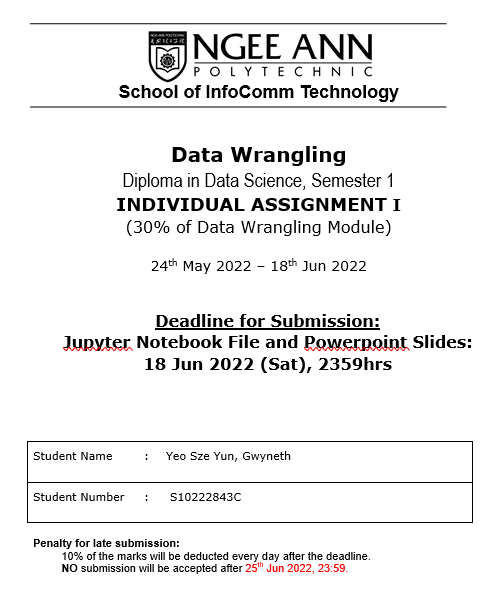

## TABLE OF CONTENTS
### [Introduction](#intro)
### [Exploration of data using TIBCO Spotfire](#exploration)
### [Importing of packages](#import)
### [Step 1: Load Data into Jupyter Notebook](#loaddata)
### [Step 2: Replacing Values, Dropping columns & Dealing with outliers](#repeatnoutliers)
### [Step 3: Train and Test Split](#traintest)
### [Step 4: Missing Value Imputation](#missing)
### [Step 5: Distribution and transforming numerical variables](#transform)
### [Step 6: Categorical Data Encoding](#encoding)
### [Step 7: Variable Discretization /Binning](#binning)
### [Step 8: Feature Engineer](#featureengineer)
### [Step 9: Linear Regression Modelling](#regressionmodel)
### [Summary and further improvements](#summary)

## Introduction <a id="intro"></a>

In this assignment, we will be exploring and preparing a supermarket dataset for modelling to predict the future sales of each product at a particular outlet. The dataset is collected from different supermarket outlets and stores in different cities, consisting of information such as the type of products sold, category of the products, outlet size, sales of the product in an outlet, etc. We will evaluate the relationship between the different variables and identify those that are useful in predicting the sales.  We will also find out the factors affecting the products and outlets which can ultimately help the supermarket management team in boosting the sales. 

### Exploration of data using TIBCO Spotfire<a id="exploration"></a>

I made use of TIBCO Spotfire to create the visualisations. By exploring the data, we are able to determine the relationships between the variables and target variable and assess whether they are useful in predicting and increasing sales. Below are my findings.

#### Item_Outlet_Sales VS Item_Weight
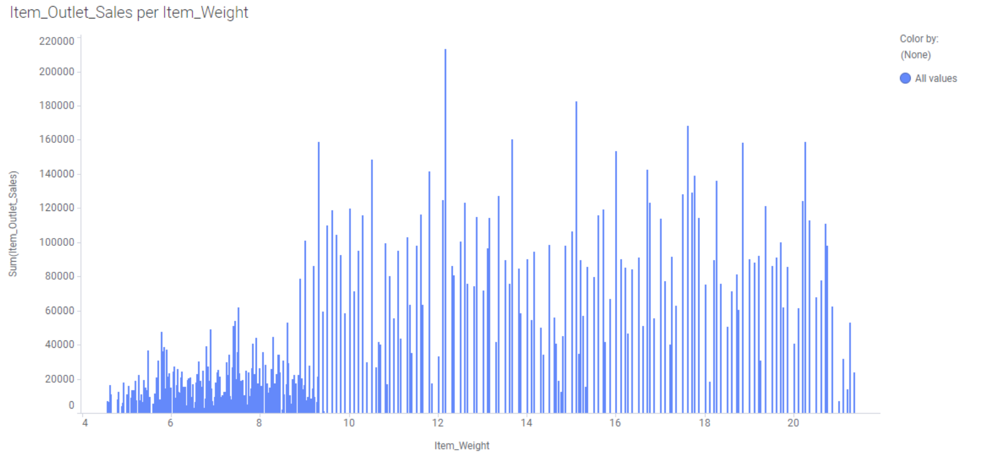
The visualisation shows that lighter weight products generate lesser sales as compared to the heavier weight products. As items like poultry, seafoods and fruits are priced accordance to their weight, there is certain degree of correlation between 'Item_Outlet_Sales' and 'Item_Weight' could be helpful in predicting the sales.

#### Item_Outlet_Sales VS Item_Fat_Content
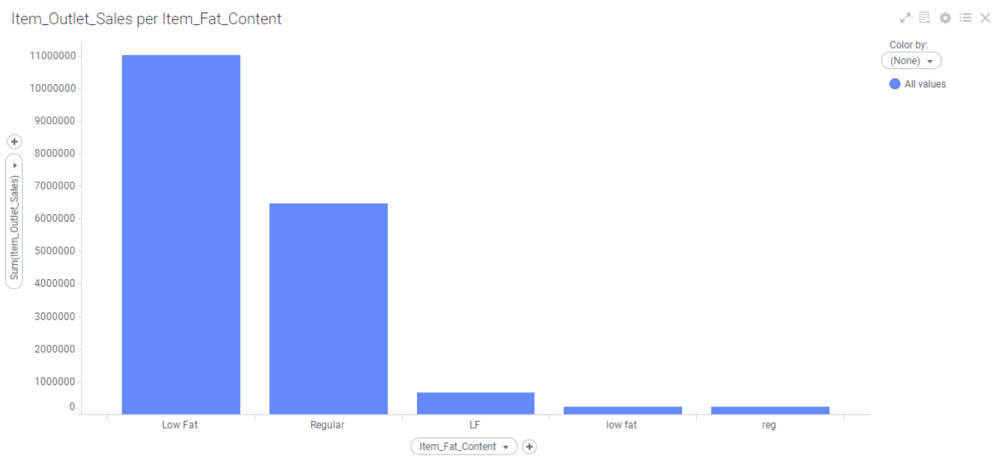
The visualisation shows that there are similar values such as “Low Fat” and “LF” and “low fat” which can be grouped into the same category. Overall, it can be seen that Low Fat products generates the most sales. This can be due to the fact that people are going for products that are healthier. Hence, we can foresee that 'Item_Fat_Content' will be helpful in increasing sales. 

#### Item_Outlet_Sales VS Item_Visibility
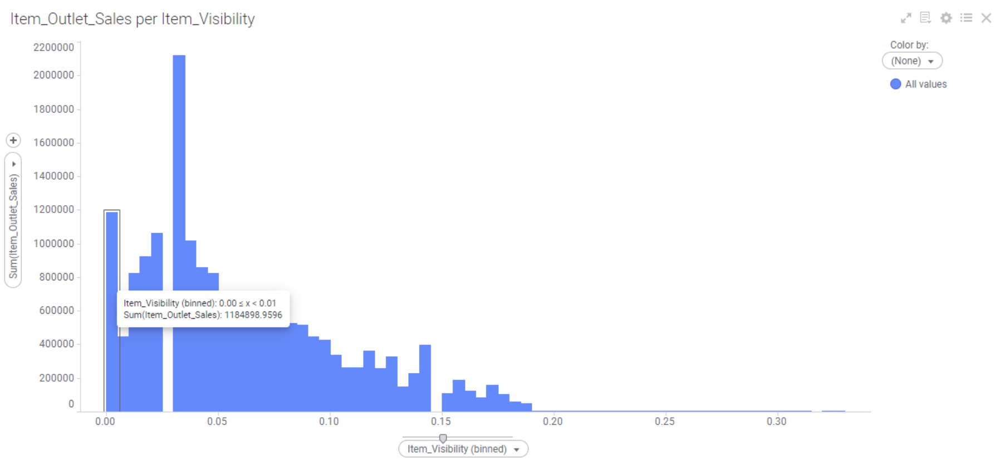
This visualisation shows the sales generated based on how visible the items are displayed. It can be seen that generally, the less visible the item is, the more sales are generated. However, since the 'Item_Visibility' is the percentage of total display area of all products in a store allocated to the particular product, it does not make sense that if the product has zero visibility, they are still able to generate sales. 'Item_Visibility' will be helpful for making predictions as the sales generated can be seen to be affected by the visibility of the item. 

#### Item_Outlet_Sales VS Item_Type
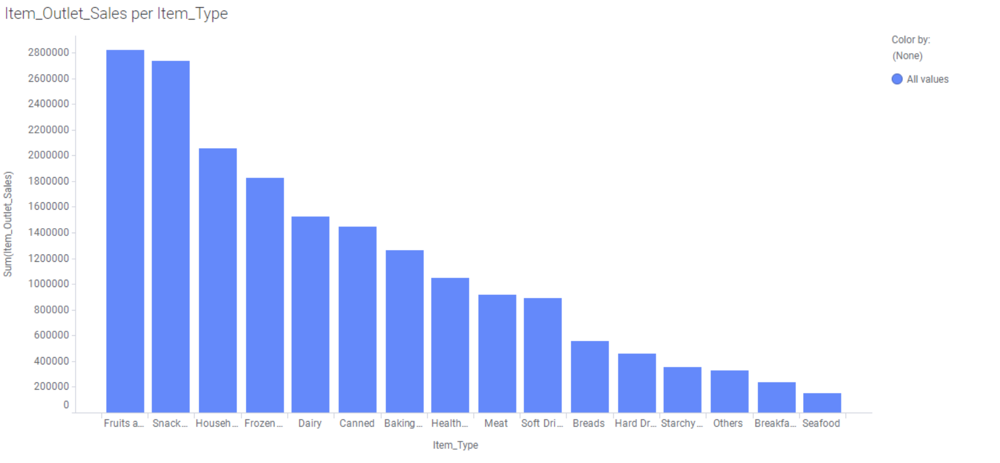
From this visualisation, fruits, vegetables, and snacks generated the top three sales. 'Item_Type' will be useful to make predictions of sales as it can be used to represent the sales generated by each product category. It also provides an overview for the supermarket management, which will be useful in making informed decision on their sale and marketing strategies. 

#### Item_Type VS Item_Fat_Content

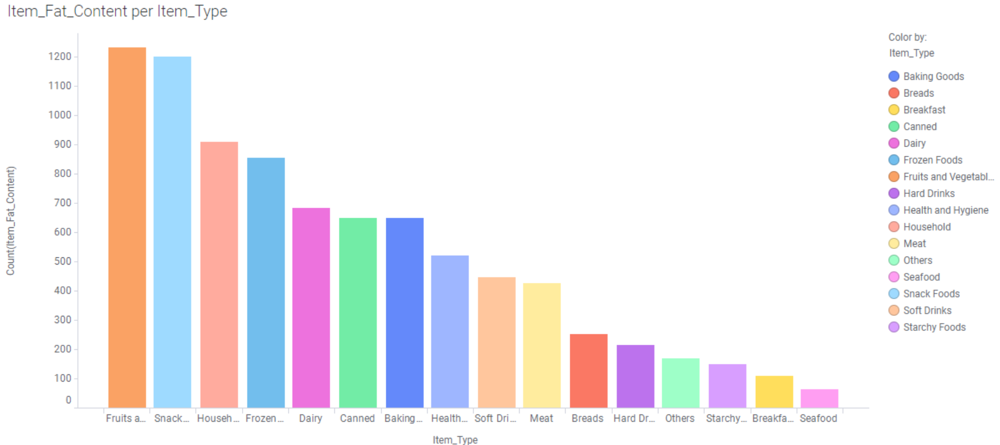
From this visualisation, it can be seen that items under 'Household' and 'Health and Hygiene' have fat content. Logically, such products should not have fat content as these products are non-edible.

#### Item_Outlet_Sales VS Item_MRP
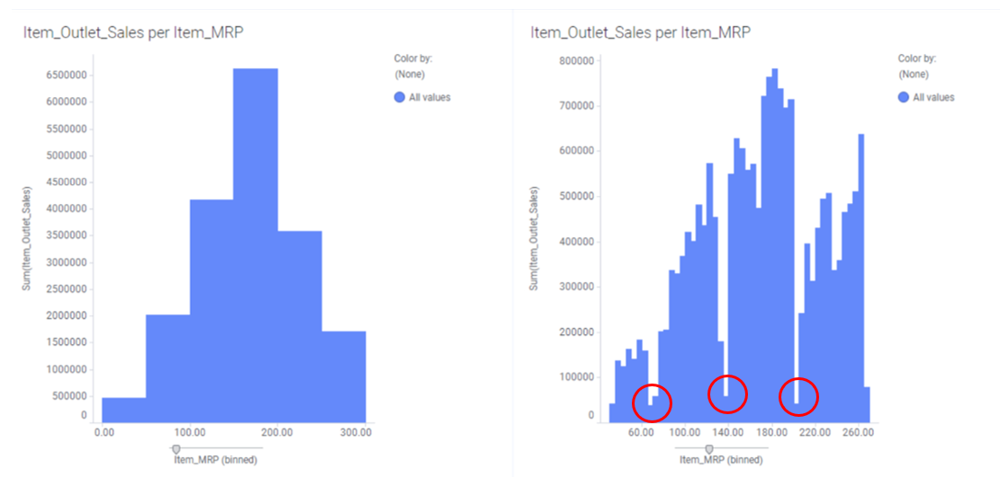
From the visualisation on the left, the item outlet sales based on the maximum retail price of the product is almost normally distributed. After performing binning, the item outlet sales is much lower (circled) for some maximum retails prices of the product. Furthermore, 'Item_MRP' will be helpful in predicting the sales but not helpful when trying to increase sales as the price of the products is at the maximum price that the product can be sold at. To increase sales, more people will need to buy the product instead of increasing the retail price of the products to generate more sales.

#### Item_Outlet_Sales VS Outlet_Identifier 
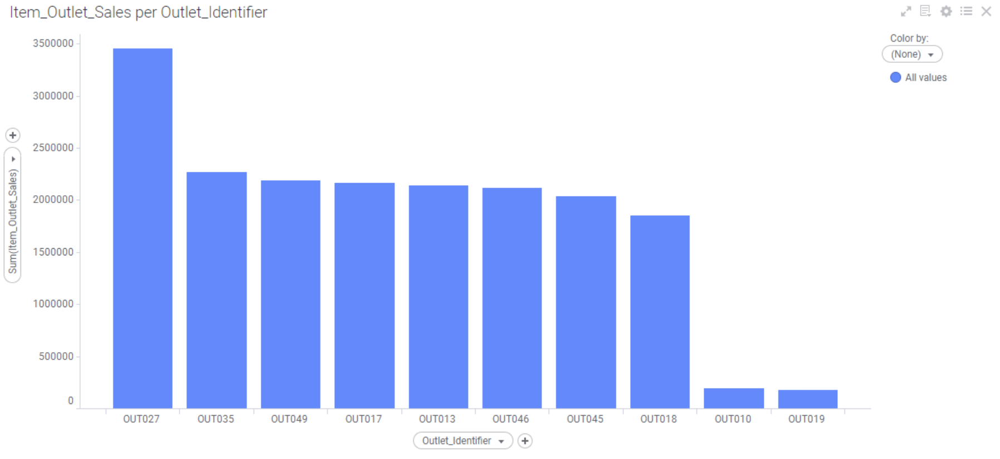
From this visualisation, it can be seen that OUT027 generates the highest sales among the outlets. The average sales generated from the outlets are approximately within the range of 1800000 dollars to 2300000 dollars. The sale generated by OUT010 and OUT019 are under the average sales. 'Outlet_Identifier' will be useful to predict the sales of each product at each particular outlet as it sets the baseline of the revenue generated by the outlets.

#### Item_Outlet_Sales VS Outlet_Establishment_Year
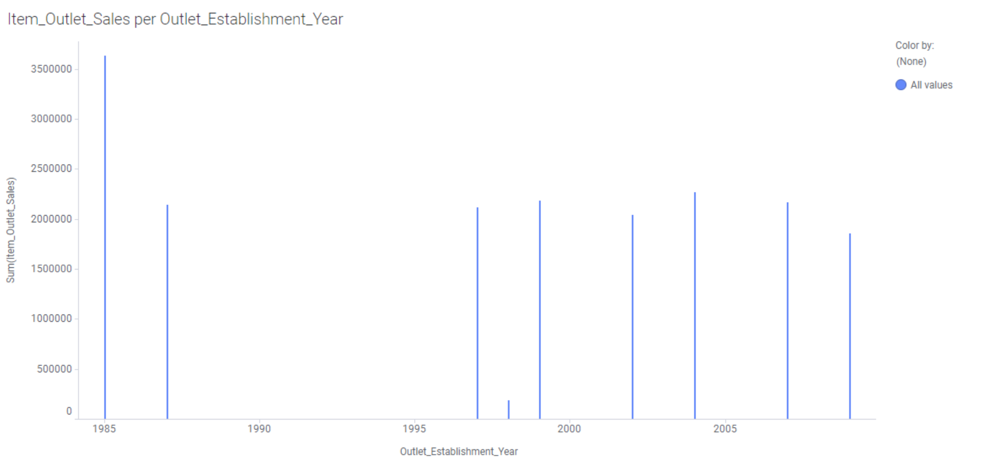
From this visualisation, it can be seen that the year of the establishment of the outlets do not affect the sales. The general assumption is that newer outlets will generate more sales but it does not represent such assumption in this case. Moreover, 'Outlet_Establishment_Year' has no relevance in predicting the sales of each product at a particular outlet.

#### Item_Outlet_Sales VS Outlet_Size 
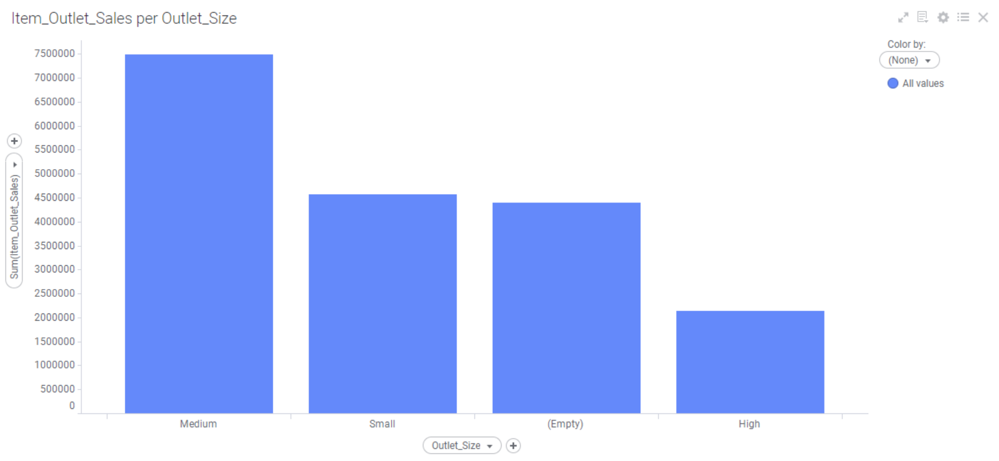
From this visualisation, it can be seen that the medium outlet stores generate the most sales. However, we also noted that there are missing values in the variable. All in all, 'Outlet_Size' might play a role in predicting sales as the size of the outlets will affect the number of products that can be displayed. This will lead to sales that are generated based on the visibility of the product.

#### Item_Outlet_Sales VS Outlet_Location_Type 
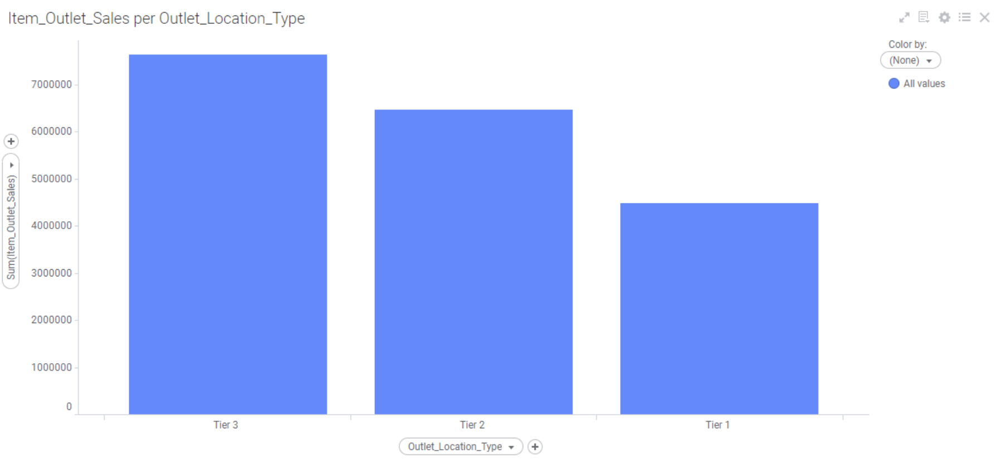
From this visualisation, it can be seen that outlets at tier 3 generates the most sales. 'Outlet_Location_Type' will be helpful in predicting the sales of each product at a particular outlet. By knowing the location, we will be able to know which outlets are in that location and the sales of product sold in those outlets. 

#### Item_Outlet_Sales VS Outlet_Type
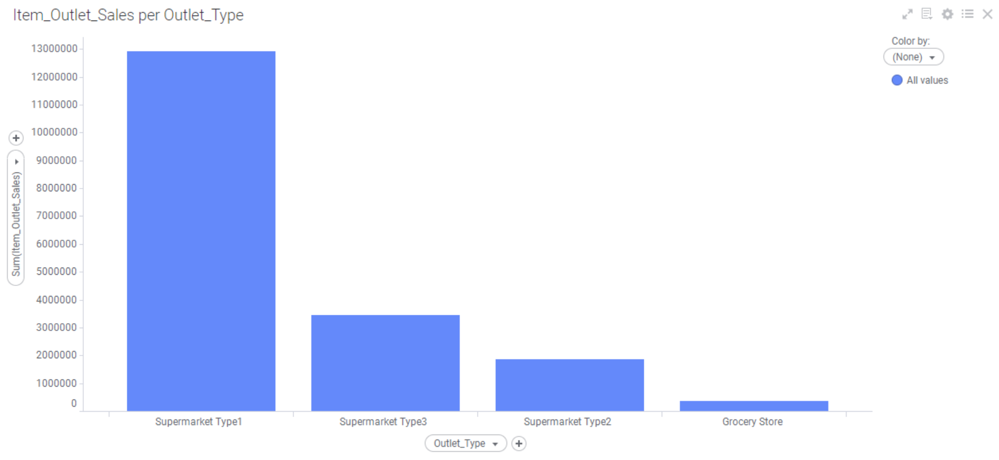
From this visualisation, it can be seen that supermarket type 1 generated the most sales. 'Outlet_Type' will be useful as we will be able to know the different products under each outlet types and predict the sales. 

## Importing of packages <a id="import"></a>

In [1]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats

from sklearn.model_selection import train_test_split

from feature_engine.transformation import PowerTransformer

from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
import feature_engine.imputation as mdi

from feature_engine.encoding import OrdinalEncoder
from feature_engine.encoding import OneHotEncoder

from sklearn.preprocessing import KBinsDiscretizer
from feature_engine.discretisation import EqualWidthDiscretiser

from sklearn.preprocessing import MinMaxScaler

## Step 1: Load Data into Jupyter Notebook <a id="loaddata"></a>

### Loading of Data

In [2]:
sm_df = pd.read_csv("./supermarket.csv") #sm refers to supermarket

### Overview of supermarket dataframe

In [3]:
#show first 5 rows of dataframe
sm_df.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052


In [4]:
#showing information of the dataframe
sm_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8523 entries, 0 to 8522
Data columns (total 12 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Item_Identifier            8523 non-null   object 
 1   Item_Weight                7060 non-null   float64
 2   Item_Fat_Content           8523 non-null   object 
 3   Item_Visibility            8523 non-null   float64
 4   Item_Type                  8523 non-null   object 
 5   Item_MRP                   8523 non-null   float64
 6   Outlet_Identifier          8523 non-null   object 
 7   Outlet_Establishment_Year  8523 non-null   int64  
 8   Outlet_Size                6113 non-null   object 
 9   Outlet_Location_Type       8523 non-null   object 
 10  Outlet_Type                8523 non-null   object 
 11  Item_Outlet_Sales          8523 non-null   float64
dtypes: float64(4), int64(1), object(7)
memory usage: 799.2+ KB


In [5]:
#description of the dataframe
sm_df.describe()

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Outlet_Sales
count,7060.000000,8523.000000,8523.000000,8523.000000,8523.000000
mean,12.857645,0.066132,140.992782,1997.831867,2181.288914
std,4.643456,0.051598,62.275067,8.371760,1706.499616
min,4.555000,0.000000,31.290000,1985.000000,33.290000
25%,8.773750,0.026989,93.826500,1987.000000,834.247400
50%,12.600000,0.053931,143.012800,1999.000000,1794.331000
75%,16.850000,0.094585,185.643700,2004.000000,3101.296400
max,21.350000,0.328391,266.888400,2009.000000,13086.964800


In [6]:
#checking for null and missing values and also number of unique values in a column 
sm_df.nunique()

Item_Identifier              1559
Item_Weight                   415
Item_Fat_Content                5
Item_Visibility              7880
Item_Type                      16
Item_MRP                     5938
Outlet_Identifier              10
Outlet_Establishment_Year       9
Outlet_Size                     3
Outlet_Location_Type            3
Outlet_Type                     4
Item_Outlet_Sales            3493
dtype: int64

In [7]:
sm_df.nunique(dropna=False)

Item_Identifier              1559
Item_Weight                   416
Item_Fat_Content                5
Item_Visibility              7880
Item_Type                      16
Item_MRP                     5938
Outlet_Identifier              10
Outlet_Establishment_Year       9
Outlet_Size                     4
Outlet_Location_Type            3
Outlet_Type                     4
Item_Outlet_Sales            3493
dtype: int64

In [8]:
#checking for number of null values in each column 
        sm_df.isnull().sum()

Item_Identifier                 0
Item_Weight                  1463
Item_Fat_Content                0
Item_Visibility                 0
Item_Type                       0
Item_MRP                        0
Outlet_Identifier               0
Outlet_Establishment_Year       0
Outlet_Size                  2410
Outlet_Location_Type            0
Outlet_Type                     0
Item_Outlet_Sales               0
dtype: int64

In [9]:
#finding categorical variables and displaying the first 5 rows 
cat_cols = [c for c in sm_df.columns if sm_df[c].dtypes=='object']
sm_df[cat_cols].head()

,Item_Identifier,Item_Fat_Content,Item_Type,Outlet_Identifier,Outlet_Size,Outlet_Location_Type,Outlet_Type
0,FDA15,Low Fat,Dairy,OUT049,Medium,Tier 1,Supermarket Type1
1,DRC01,Regular,Soft Drinks,OUT018,Medium,Tier 3,Supermarket Type2
2,FDN15,Low Fat,Meat,OUT049,Medium,Tier 1,Supermarket Type1
3,FDX07,Regular,Fruits and Vegetables,OUT010,NaN,Tier 3,Grocery Store
4,NCD19,Low Fat,Household,OUT013,High,Tier 3,Supermarket Type1


In [10]:
#finding numerical variables and displaying the first 5 rows
num_cols = [n for n in sm_df.columns if sm_df[n].dtypes!='object']
sm_df[num_cols].head()

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Outlet_Sales
0,9.30,0.016047,249.8092,1999,3735.1380
1,5.92,0.019278,48.2692,2009,443.4228
2,17.50,0.016760,141.6180,1999,2097.2700
3,19.20,0.000000,182.0950,1998,732.3800
4,8.93,0.000000,53.8614,1987,994.7052


## Step 2: Replacing Values, Dropping columns & Dealing with outliers <a id="repeatnoutliers"></a>

### Replacing repeat values

In [11]:
sm_df['Item_Fat_Content'].replace("low fat","Low Fat", inplace = True)
sm_df['Item_Fat_Content'].replace("LF","Low Fat", inplace = True)
sm_df['Item_Fat_Content'].replace("reg","Regular", inplace = True)
sm_df['Item_Fat_Content'].unique()

array(['Low Fat', 'Regular'], dtype=object)

Using visualisations created to analyse the data, I realised that under 'Item_Fat_Content', the naming of the values is different such as "Low Fat", "LF" and "low fat" and "reg" and "Regular" but they are similar in nature. For data consistency, I have replaced "low fat" and "LF" to "Low Fat" and "reg" to "Regular".  

### Replacing wrong values

In [12]:
sm_df['Item_Fat_Content'] = np.where((sm_df.Item_Type == 'Household'),'No Fat Content',sm_df.Item_Fat_Content)
sm_df['Item_Fat_Content'] = np.where((sm_df.Item_Type == 'Health and Hygiene'),'No Fat Content',sm_df.Item_Fat_Content)

Based on the visualisations made when exploring the data, it can be seen that there was fat content under 'Household' and 'Health and Hygiene' products. Logically, such products that are non-edible should not have fat content. Therefore, I replaced the item fat content values in these 2 categories to 'No Fat Content'. The rationale for replacing the values instead of dropping is because it will affect a large proportion of the dataset, making the dataset inaccurate.

### Dropping columns 

In [13]:
sm_df.drop('Outlet_Establishment_Year', inplace=True, axis=1)

I dropped the 'Outlet_Establishment_Year' column as there is no correlation between sales and establishment year. Hence, it will not be useful in helping to predict the sales.

In [14]:
sm_df.drop('Item_Identifier', inplace=True, axis = 1)

When executing the code for encoding of categorical variables, there was warning message whereby Nan values were introduced in ‘Item_Identifier’.

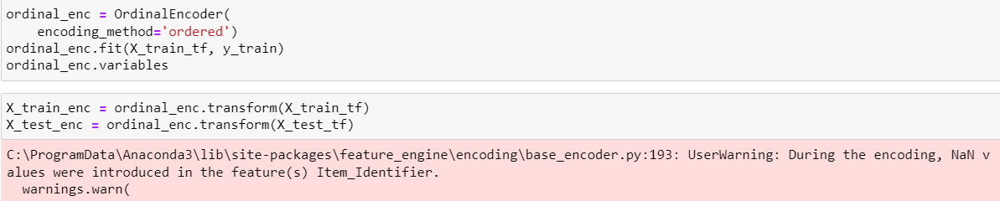

After doing train test split, the dataset will be split into 70% train and 30% test. There is a chance that for categories inside ‘Item_Identifier’ with fewer data, they will all be allocated into the test data. Thus, when encoding in the train data, the dictionary will not have any encoded values of that category, leading to NaN values being introduced in the train data for these categories. Hence, it will be best to drop the column.

### Identifying and dealing with outliers
It is needed to identify outliers and see whether the outliers make sense. If the outliers are deemed as an error or is significantly different from the rest of the data, it has to be removed to ensure that the machine learning algorithms will not underperform and the predictions will be more accurate. 

Firstly, we will find out which variables has outliers. I used boxplot to find for outliers.

Text(0.5, 1.0, 'Overview Boxplot of numerical variables')

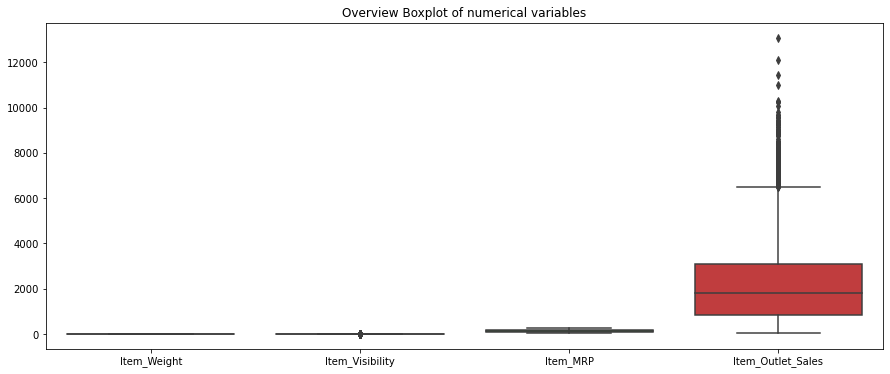

In [15]:
plt.figure(figsize=(15,6))
sns.boxplot(data=sm_df)
plt.title('Overview Boxplot of numerical variables')

From the above visualisation, it can be seen that 'Item_Outlet_Sales' has outliers. However, since it is hard to see whether there are outliers for the rest of the variables, I created individual boxplots for each to better explore the data.

<AxesSubplot:xlabel='Item_MRP'>

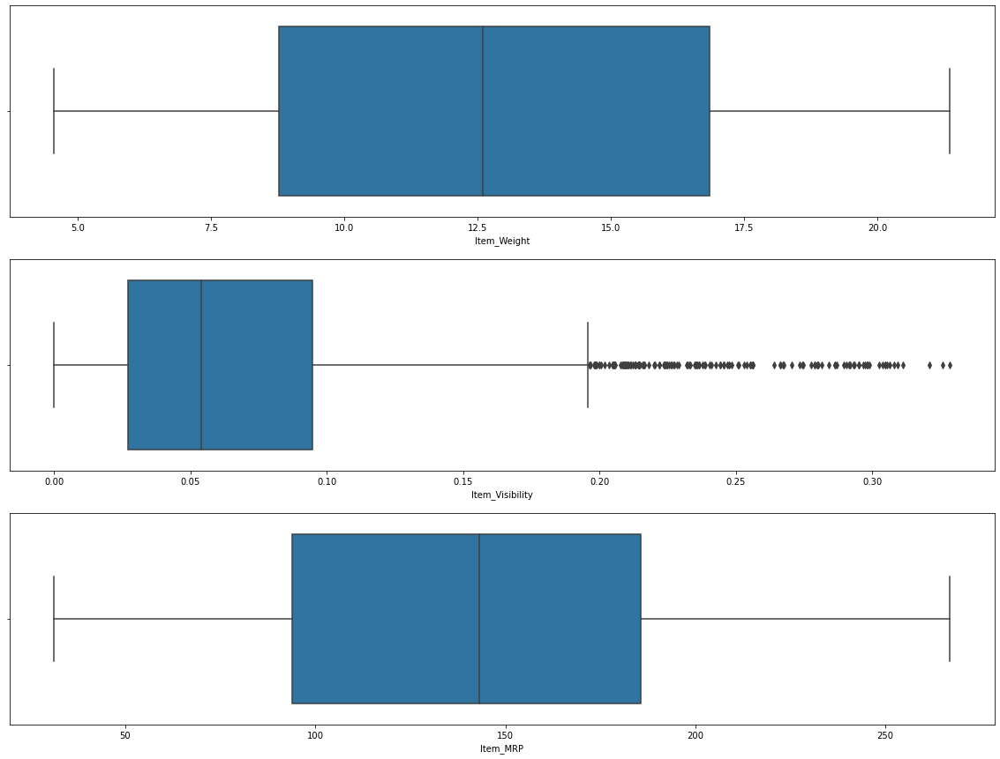

In [16]:
figure, axs = plt.subplots(3,1, figsize=(20,15))

sns.boxplot(x = sm_df['Item_Weight'],ax=axs[0])
sns.boxplot(x = sm_df['Item_Visibility'], ax=axs[1])
sns.boxplot(x = sm_df['Item_MRP'], ax=axs[2])

From the above, it can be seen that 'Item_Visibility' has outliers.

As for the dealing of the outliers, I decided not to remove the outliers under 'Item_Outlet_Sales' as the outliers is legitimate data which shows the top sales of the product in a particular store. 

As mentioned above in the exploration of data section, the assumption is that there should not be sales when the product is not visible. Hence, I decided to remove all the rows in 'Item_Visibility' that has a value of 0. This is because, replacing it with a value such as the mean/median will cause the data to become incorrect, biased and skewed.

In [17]:
sm_df2 = sm_df.copy() #duplicate dataset first for backup
sm_df2.drop(sm_df2[sm_df2['Item_Visibility'] == 0].index, inplace = True)

<AxesSubplot:xlabel='Item_Visibility'>

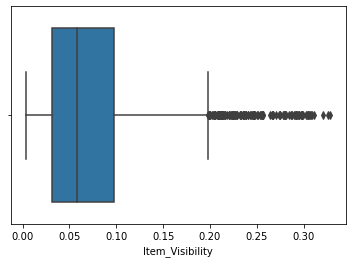

In [18]:
sns.boxplot(x = sm_df2['Item_Visibility'])

Even after removing the wrong data, it can be seen from the boxplot that there are still "outliers". However, those are legitimate data as it displays the top visibility of the products. Moreover, if we cap those "outliers", it will be replaced by the boundary values. This is not ideal as we want to use 'Item_Visibility' to predict the sales. If it is not the original data, the predicted results will not be as accurate. Hence, I will not be dealing with the "outliers". 

## Step 3: Train and Test Split <a id="traintest"></a>

In [19]:
X_train, X_test, y_train, y_test = train_test_split(
    sm_df2.drop('Item_Outlet_Sales', axis=1), sm_df2['Item_Outlet_Sales'], test_size=0.3, random_state=0)

In [20]:
X_train.shape, X_test.shape

((5597, 9), (2400, 9))

## Step 4: Missing Value Imputation <a id="missing"></a>

From the exploration of data and overview of dataset, we can see that there are missing or NaN values. For easier reference, we will check the columns that have missing values in the code below. 

In [21]:
# find the percentage of missing data per variable for X_train
X_train.isnull().mean()

Item_Weight             0.175630
Item_Fat_Content        0.000000
Item_Visibility         0.000000
Item_Type               0.000000
Item_MRP                0.000000
Outlet_Identifier       0.000000
Outlet_Size             0.279435
Outlet_Location_Type    0.000000
Outlet_Type             0.000000
dtype: float64

From the above, we can see that 'Item_Weight' and 'Outlet_Size' contains missing and NaN values.

### Assembling imputation pipeline with Feature Engine to replace missing values

Assembling imputation pipeline allows us to impute all the missing data in one step. It does not make sense to drop all the missing data in ‘Item_Weight’ and ‘Outlet_Size’ as there is too much missing data to drop. We may end up deleting useful information from the dataset instead. I will be replacing the missing values in ‘Outlet_Size’ with the word ‘Missing’. I did not do mode imputation as it can lead to biased estimates. I will be replacing the missing values in ‘Item_Weight’ with the median as it will lead to unbiased estimates. There is because there is no other value that I deem meaningful to be replaced by other than the median. If I were to replace the missing values with Arbitrary values without any explanation, I will be introducing unwanted bias. As for end-of-tail imputation, it may distort the distribution of the original variables. 

In [22]:
# making a list with the numerical and categorical variables
features_num_median = ['Item_Weight']
features_cat_missing = ['Outlet_Size']

In [23]:
# instantiating each imputer within a pipeline
pipe = Pipeline(steps=[
    ('imp_num_median', mdi.MeanMedianImputer(imputation_method = 'median', variables=features_num_median)),
    ('imp_cat_missing', mdi.CategoricalImputer(variables=features_cat_missing, imputation_method='missing'))
])

In [24]:
# fit the preprocessor
pipe.fit(X_train)

Pipeline(steps=[('imp_num_median',
                 MeanMedianImputer(variables=['Item_Weight'])),
                ('imp_cat_missing',
                 CategoricalImputer(variables=['Outlet_Size']))])

In [25]:
# imputing the data
X_train = pipe.transform(X_train)
X_test = pipe.transform(X_test)

In [26]:
# check null and missing values are replaced in X_train
pd.DataFrame(X_train).isnull().sum()

Item_Weight             0
Item_Fat_Content        0
Item_Visibility         0
Item_Type               0
Item_MRP                0
Outlet_Identifier       0
Outlet_Size             0
Outlet_Location_Type    0
Outlet_Type             0
dtype: int64

In [27]:
# check null and missing values are replaced in X_test
pd.DataFrame(X_test).isnull().sum()

Item_Weight             0
Item_Fat_Content        0
Item_Visibility         0
Item_Type               0
Item_MRP                0
Outlet_Identifier       0
Outlet_Size             0
Outlet_Location_Type    0
Outlet_Type             0
dtype: int64

## Step 5: Distribution and transforming numerical variables <a id="transform"></a>

### Find which are numerical variables in X_train
Firstly, we will look at the remaining numerical variables in X_train that we did not drop to aid in the transformations and coding later. 

In [28]:
X_num_cols = [n for n in X_train.columns if X_train[n].dtypes!='object']
X_train[X_num_cols].head()

,Item_Weight,Item_Visibility,Item_MRP
654,12.800,0.076060,95.1410
7348,10.895,0.020952,255.3672
7762,10.395,0.112325,60.6220
1849,20.200,0.112321,123.6046
8189,11.500,0.020612,84.9540


### Distribution of numerical data 
We will look at the distribution of the numerical variables and see whether they are normally distributed.

In [29]:
# plot histogram and Q-Q plots to have a look at the variable distribution after transformation
def diagnostic_plots(df, variable):
    # function takes a dataframe (df) and
    # the variable of interest as arguments

    # define figure size
    plt.figure(figsize=(16, 4))

    # histogram
    plt.subplot(1, 3, 1)
    sns.distplot(df[variable], bins=30)
    plt.title('Histogram')

    # Q-Q plot
    plt.subplot(1, 3, 2)
    stats.probplot(df[variable], dist="norm", plot=plt)
    plt.ylabel('RM quantiles')

    # boxplot
    plt.subplot(1, 3, 3)
    sns.boxplot(y=df[variable])
    plt.title('Boxplot')

    plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


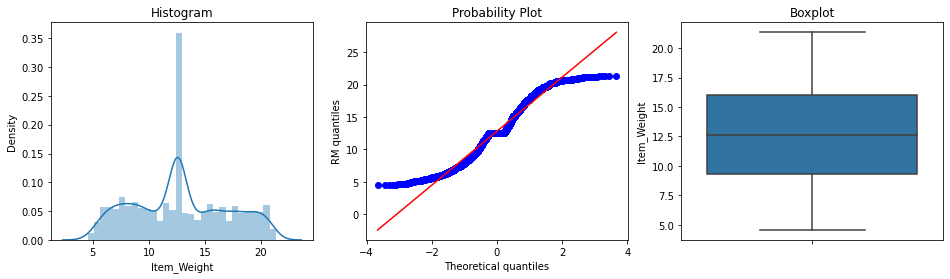

In [30]:
diagnostic_plots(X_train, 'Item_Weight')

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


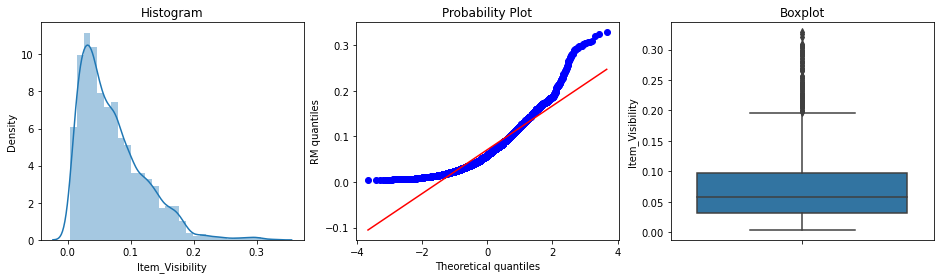

In [31]:
diagnostic_plots(X_train, 'Item_Visibility')

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


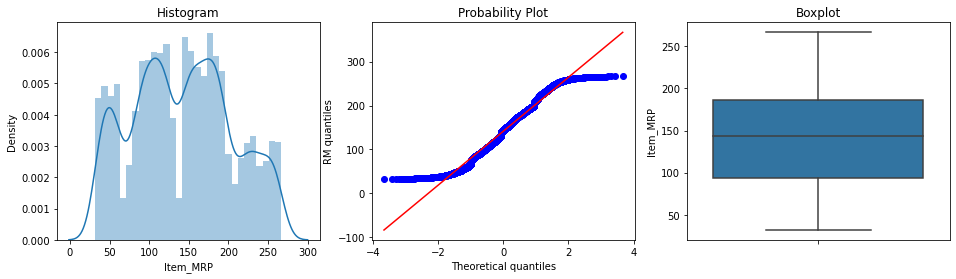

In [32]:
diagnostic_plots(X_train, 'Item_MRP')

From the above distributions, it can be seen that the variables are not normally distributed. Some machine learning models presume that the variables are normally distributed and when they are not, we have to transform these numerical variables to become normally distributed. This is because it can help to find a linear relationship between the numerical variables and the target variable. Furthermore, when the variables are normally distributed, it is easier to predict a variable and find its probability within a range of values. Hence, it will benefit us later in the model if we transform the variables to become as normally distributed as possible. 

I will be using different transformation methods taught for numerical variables and compare them. I will apply the method which makes the variable more normally distributed. In the event whereby there seems to be little changes compared to the original distribution, I will not transform depending on the outcome of the model score. 

Below are the different transformation methods I applied to the different variables, along with the histogram, probability and boxplots.

### Item_Weight

#### Log transformation 
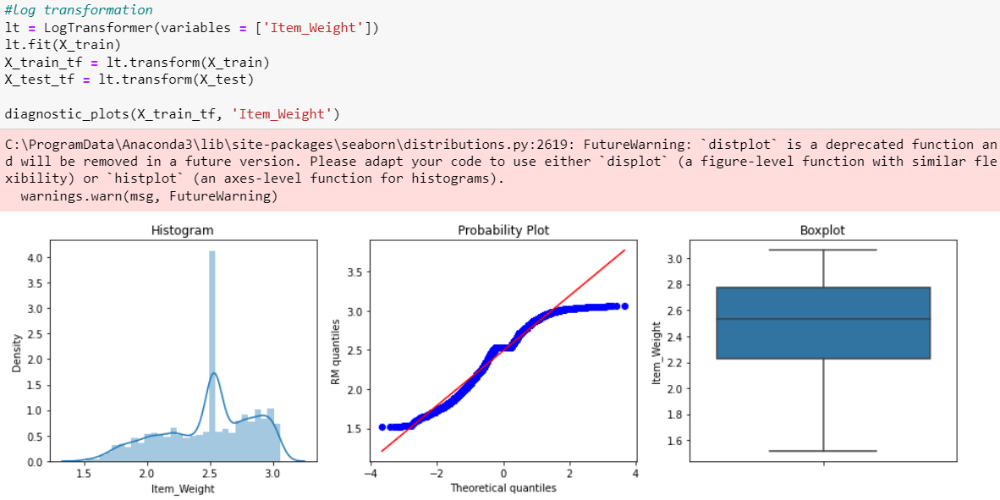

#### Reciprocal transformation
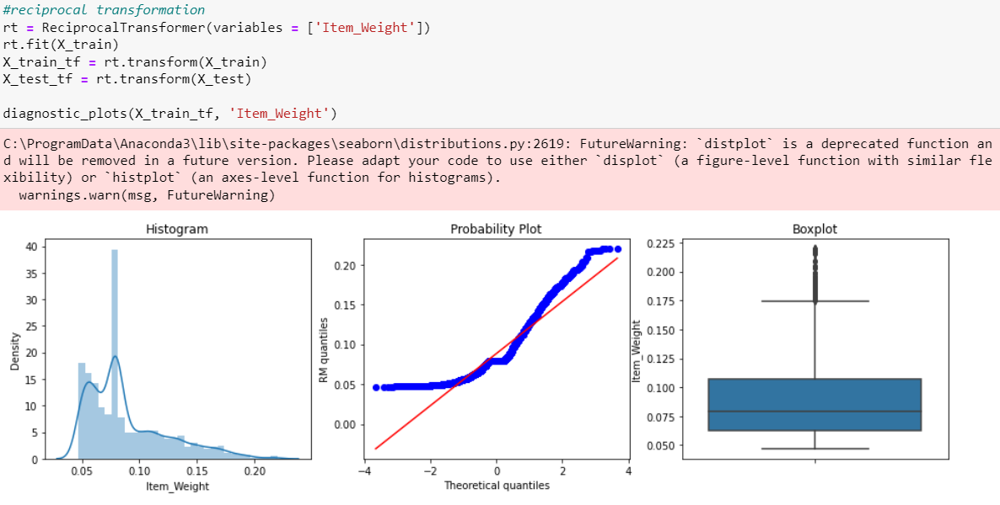

#### Square root transformation 
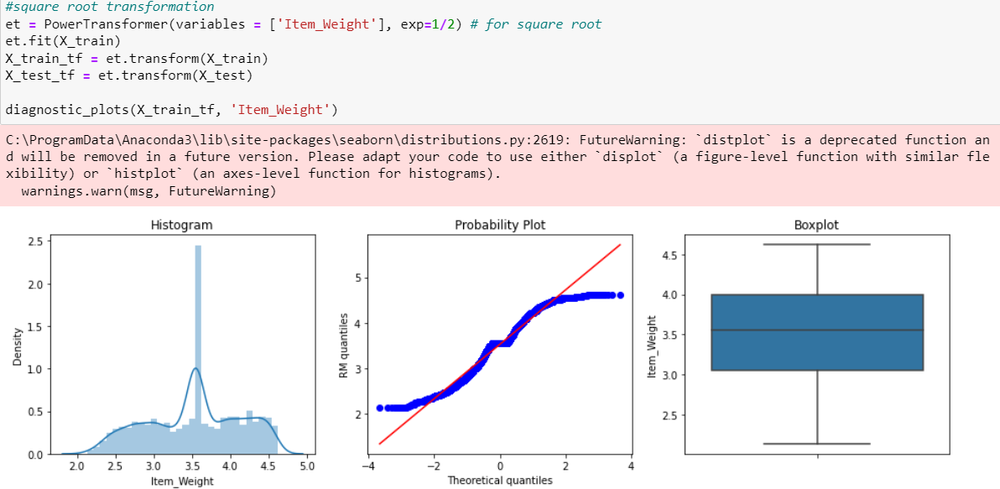

#### Cube root transformation
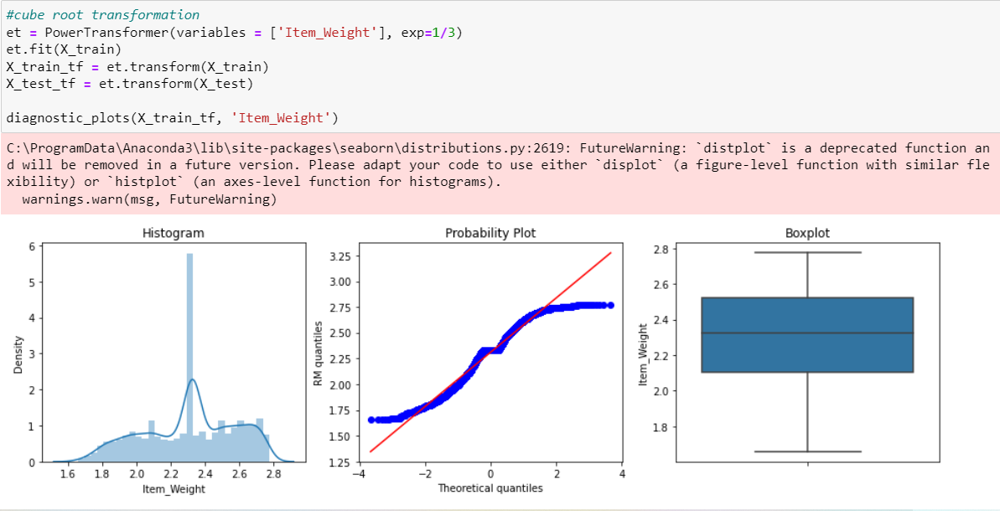

#### Power transformation
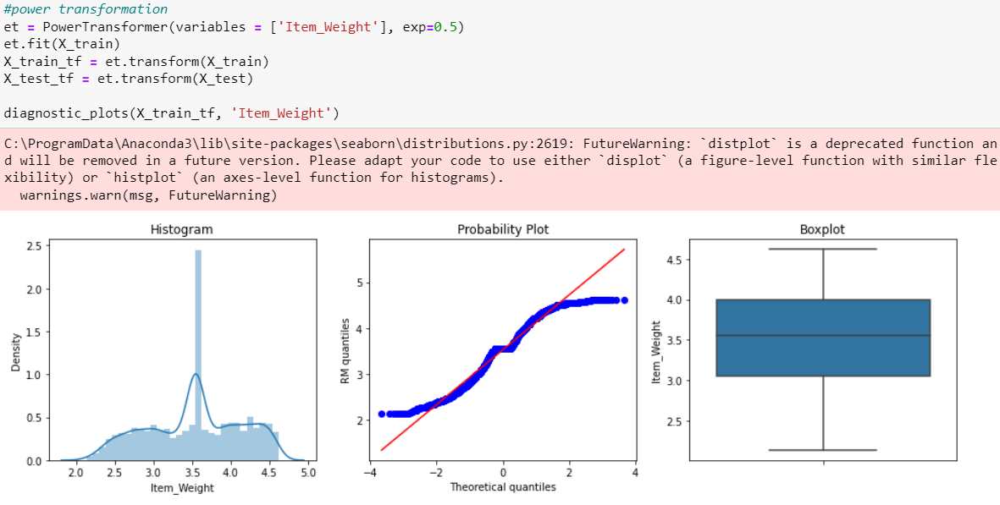

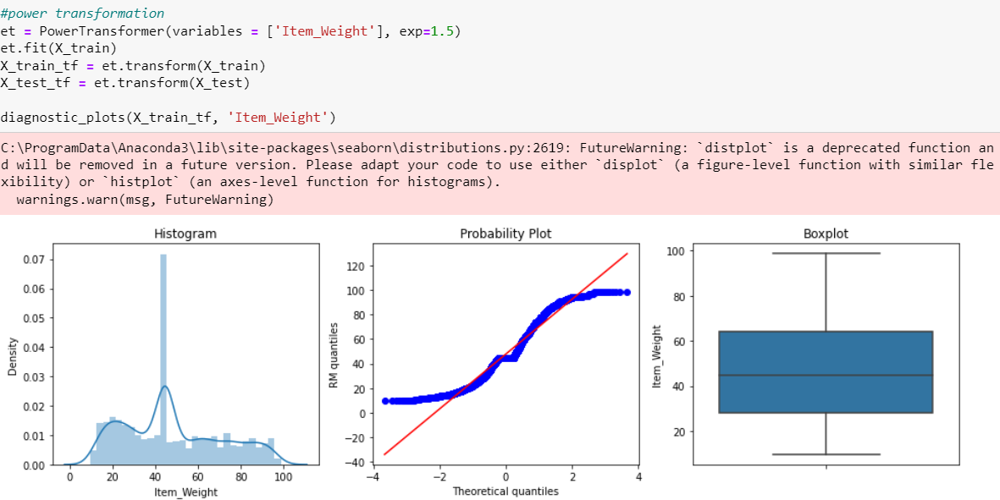

From the 2 histogram above, we can see that the bigger the exponent, the more right skewed the histogram becomes. 

#### Box-cox transformation
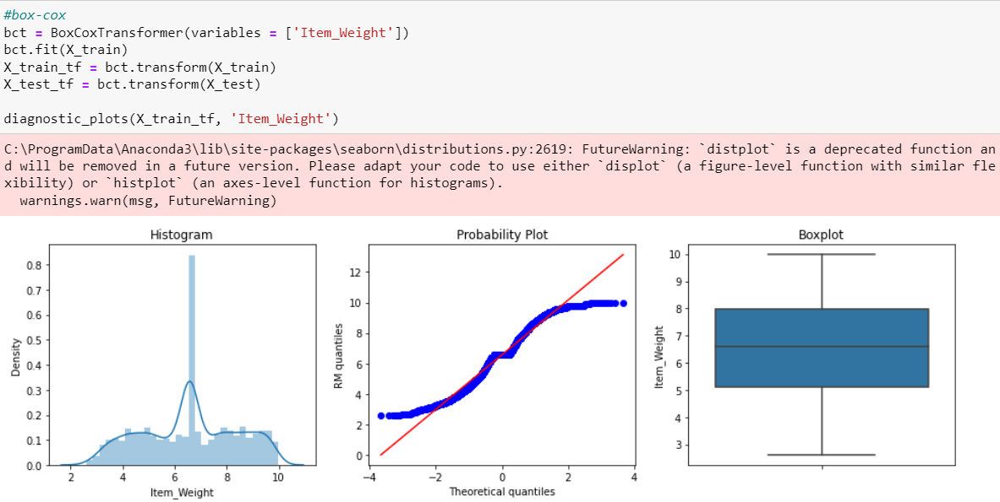

#### Yeo-johnson transformation
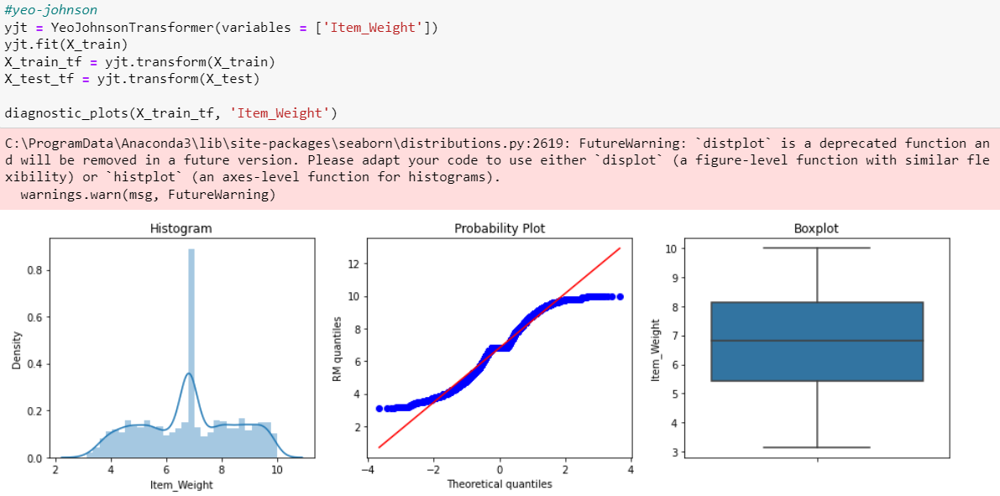

Looking at the graphs based on the different transformations for 'Item_Weight', we can see that most of the Q-Q plots are around the same. Hence, I looked at the histogram to see the distribution. However, even after looking at the histogram, I was still not able to distinguish which transformation made 'Item_Weight' more normally distributed. 

I also realised that the probability and histogram plots were very similar to the distribution before transformation. This tells me that there may not be a point in transforming. Even so, I went with using Yeo-johnson to transform ‘Item_Weight’ first because it is known to be the best transformation method as it is able to cater to any numerical number. Next, I transformed using the transformation methods that produced similar plots and see the model results. After that, I tried not to transform ‘Item_Weight’ and my model performance results improved (will be shared in the Linear Regression Model section). Thus, I chose to not transform ‘Item_Weight’ for my final model. 

### Item_Visibility

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


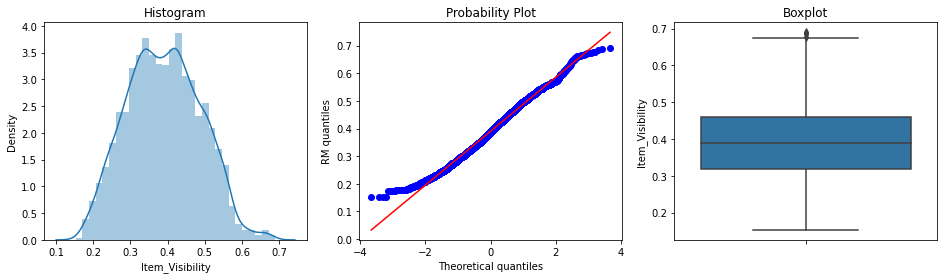

In [33]:
#cube root transformation
et = PowerTransformer(variables = ['Item_Visibility'], exp=1/3)
et.fit(X_train)
X_train_tf = et.transform(X_train)
X_test_tf = et.transform(X_test)

diagnostic_plots(X_train_tf, 'Item_Visibility')

#### Log transformation
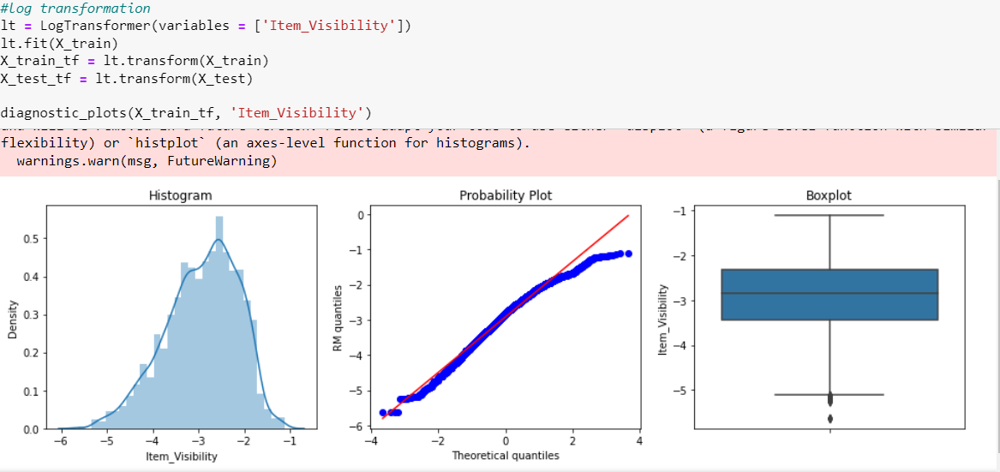

#### Reciprocal transformation
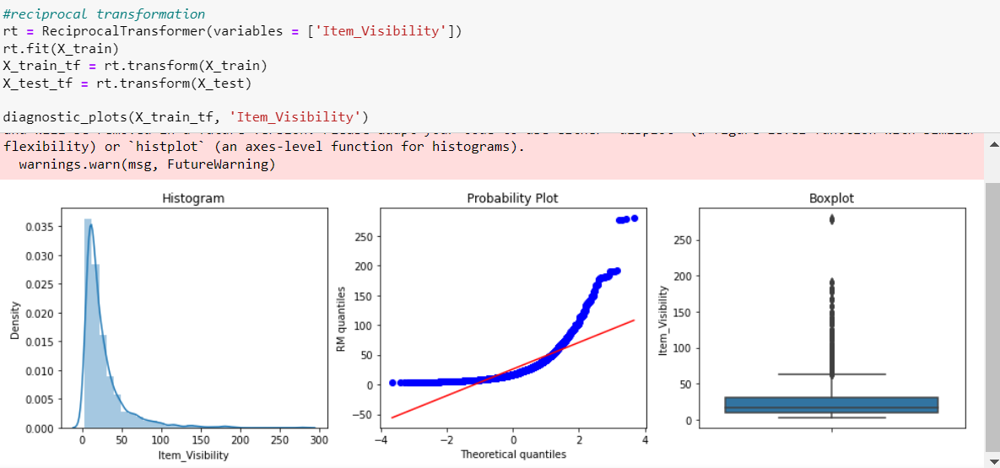

#### Square root transformation 
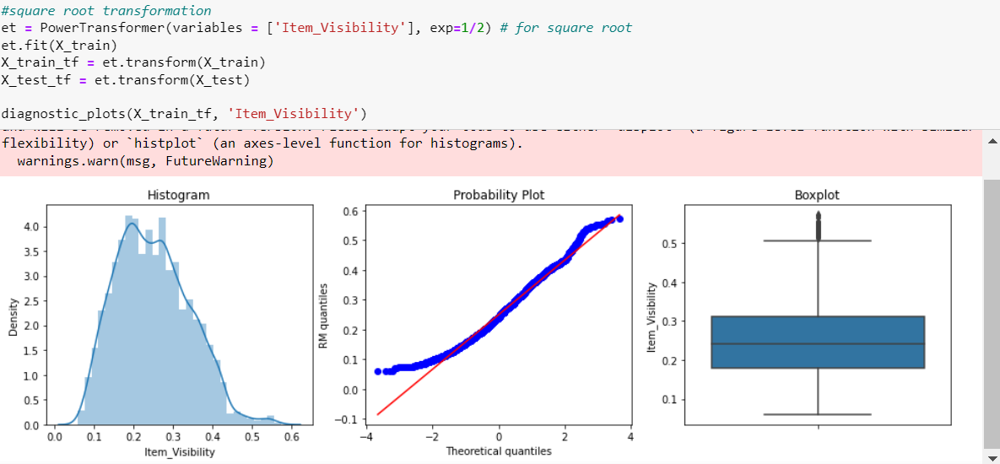

#### Power transformation
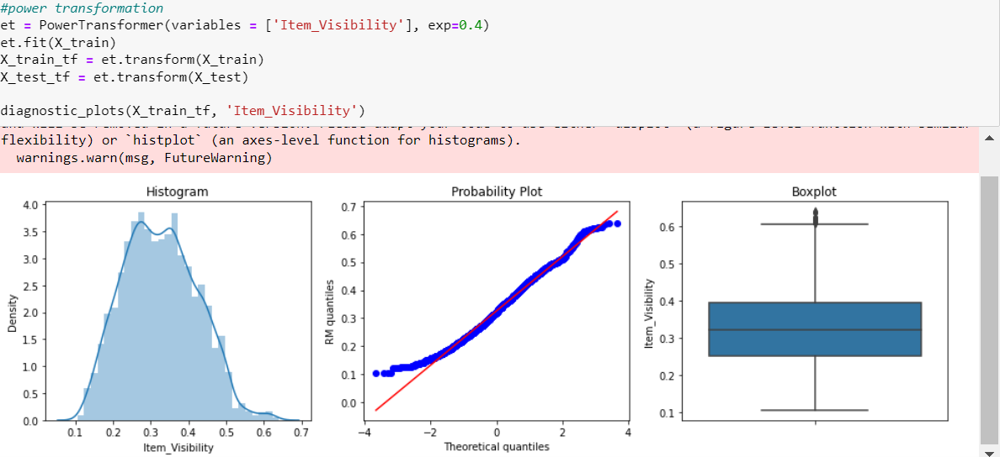
To find which exponent helps to make the distribution more normal, I realised that the smaller the exponent, the more skewed the histogram is. Hence, not including 0.3 and 0.5, when the exponent is 0.4, the histogram is not normally distributed, but it is the closest to being normally distributed. 

#### Box-cox transformation
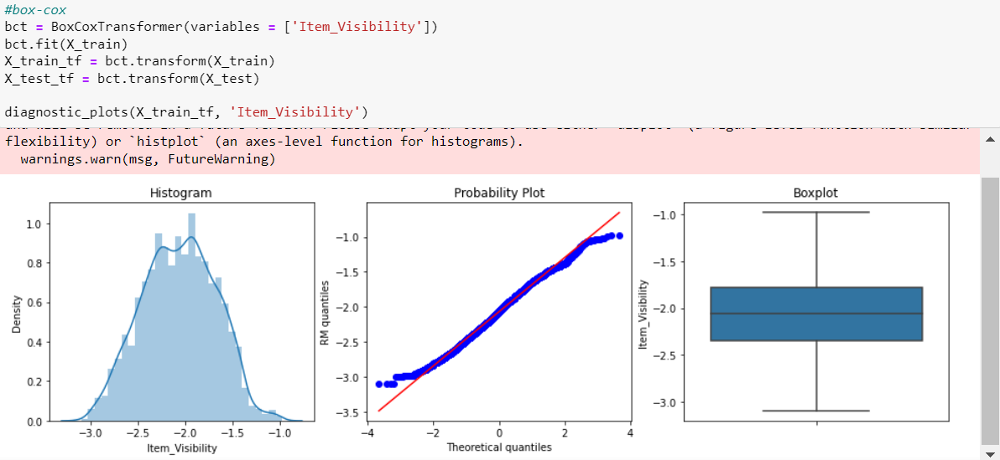

#### Yeo-johnson transformation
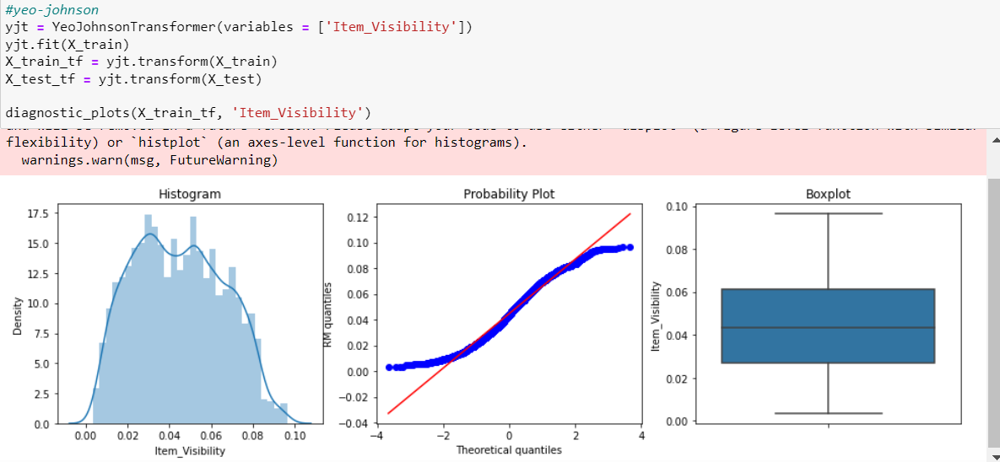

After looking at the Q-Q plots of all the transformations for 'Item_Visibility', the cube root transformation transformed the variable from being right skewed to the closest to a normal distribution. Thus, I chose to transform 'Item_Visibility' using cube root transformation. 

### Item_MRP

#### Log transformation
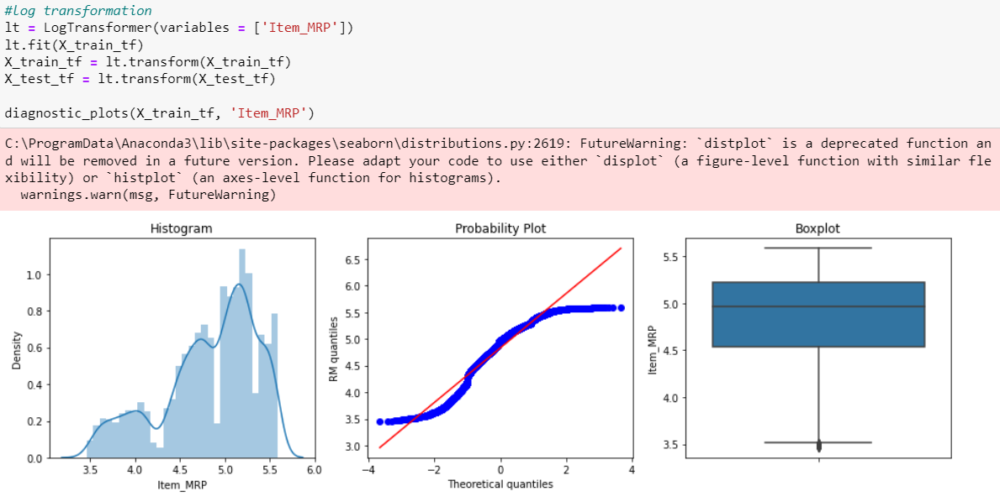

#### Reciprocal transformation
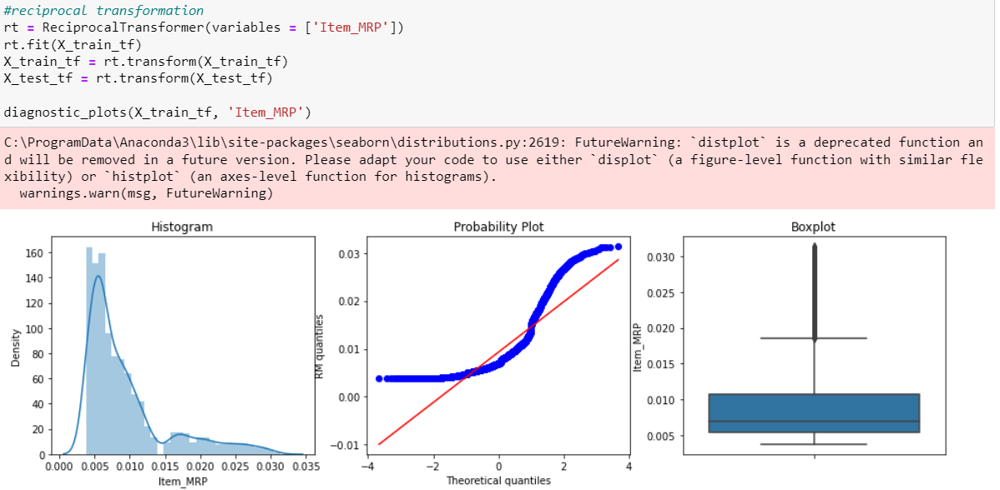

#### Square root transformation
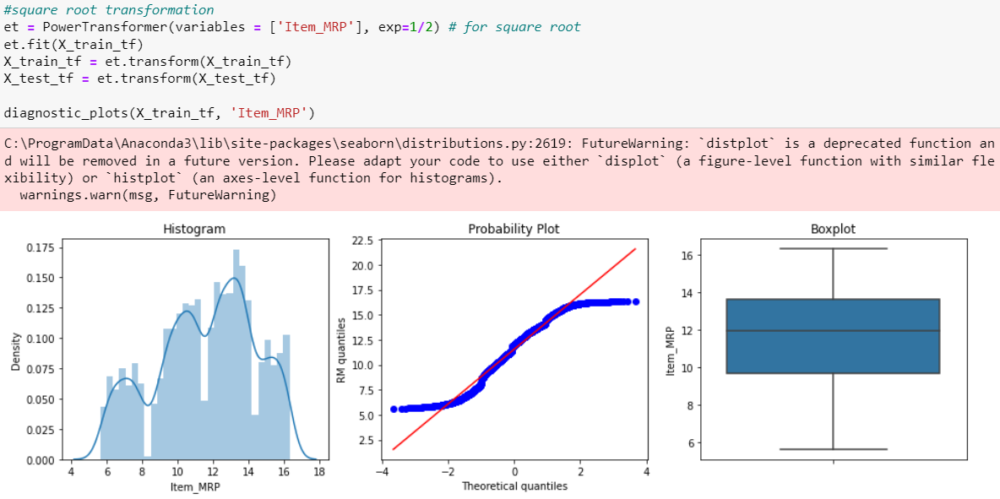

#### Cube root transformation
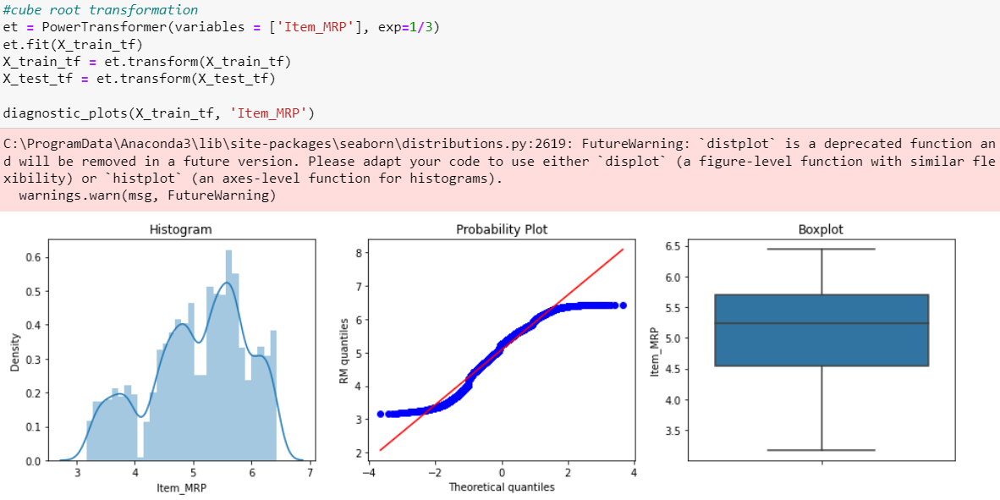

#### Power transformation
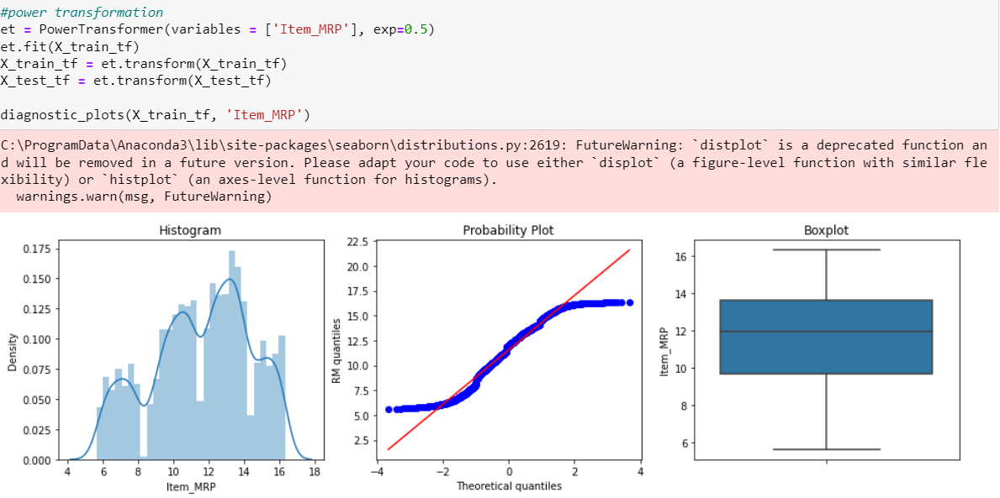

#### Box-cox transformation
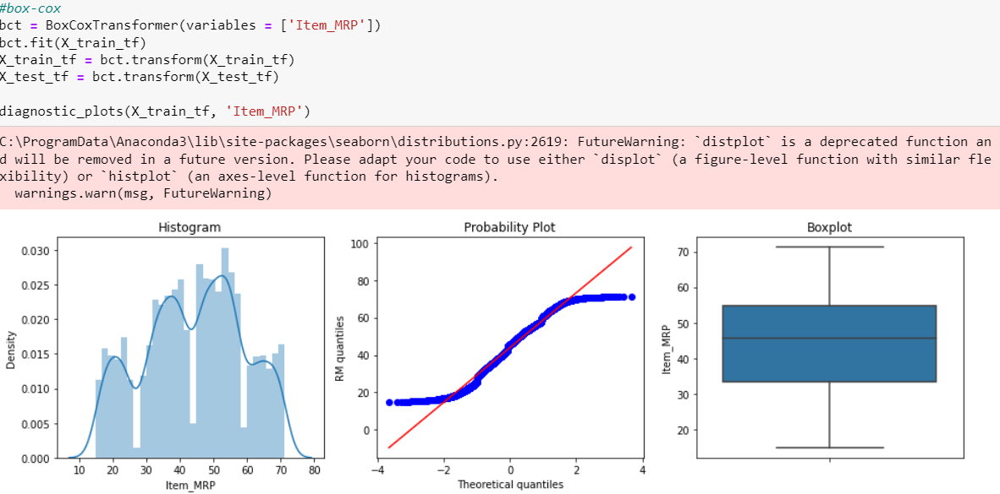

#### Yeo-johnson transformation
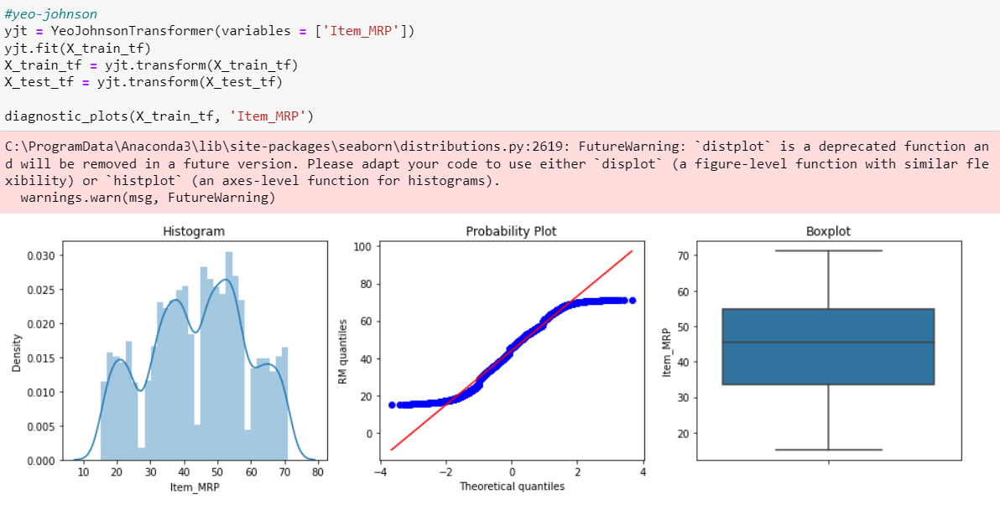

Looking at the visualisations of all the different transformation methods done on 'Item_MRP', most of the probability and histogram plots are very similar. Moreover, there is no significant difference when comparing the plots before and after transformation. This once again tells me that there may not be a point in transforming 'Item_MRP'. Nevertheless, I still experimented and used the Yeo-johnson transformation as it is the better transformation method. After that, I transformed using the transformations that produced similar plots and also tried a trial without transforming. I discovered that if I did not transform, the model results improved (will be shared in the Linear Regression Model section). Hence, I did not transform 'Item_MRP' as there wasn't a point in transforming it. 

## Step 6: Categorical Data Encoding <a id="encoding"></a>

### Find categorical columns in X_train
We will look at the remaining categorical variables in X_train that we did not drop to help in encoding. 

In [34]:
cat_cols = [c for c in X_train_tf.columns if X_train_tf[c].dtypes=='object']
X_train_tf[cat_cols].head()

,Item_Fat_Content,Item_Type,Outlet_Identifier,Outlet_Size,Outlet_Location_Type,Outlet_Type
654,Low Fat,Fruits and Vegetables,OUT046,Small,Tier 1,Supermarket Type1
7348,No Fat Content,Health and Hygiene,OUT046,Small,Tier 1,Supermarket Type1
7762,Low Fat,Snack Foods,OUT045,Missing,Tier 2,Supermarket Type1
1849,No Fat Content,Household,OUT046,Small,Tier 1,Supermarket Type1
8189,Regular,Dairy,OUT045,Missing,Tier 2,Supermarket Type1


We have to encode categorical data into numerical format so that the data can be passed into the model to improve predictions as most models are not able to handle categorical variables. I used ordinal and one hot encoding for my final model. 

### Ordinal encoding

In [35]:
ordinal_enc = OrdinalEncoder(
    encoding_method='ordered',
variables = ['Item_Fat_Content','Outlet_Identifier', 'Outlet_Size','Outlet_Location_Type','Item_Type'])
ordinal_enc.fit(X_train_tf, y_train)

OrdinalEncoder(variables=['Item_Fat_Content', 'Outlet_Identifier',
                          'Outlet_Size', 'Outlet_Location_Type', 'Item_Type'])

In [36]:
X_train_enc = ordinal_enc.transform(X_train_tf)
X_test_enc = ordinal_enc.transform(X_test_tf)

### One hot encoding 

In [37]:
ohe_enc = OneHotEncoder(
    top_categories=None,
    drop_last=False,
variables = ['Outlet_Type'])
ohe_enc.fit(X_train_enc)

OneHotEncoder(variables=['Outlet_Type'])

In [38]:
X_train_enc = ohe_enc.transform(X_train_enc)
X_test_enc = ohe_enc.transform(X_test_enc)

In [39]:
X_train_enc.head()

,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Size,Outlet_Location_Type,Outlet_Type_Supermarket Type1,Outlet_Type_Supermarket Type2,Outlet_Type_Supermarket Type3,Outlet_Type_Grocery Store
654,12.800,0,0.423694,9,95.1410,5,1,0,1,0,0,0
7348,10.895,1,0.275681,5,255.3672,5,1,0,1,0,0,0
7762,10.395,0,0.482494,13,60.6220,3,0,2,1,0,0,0
1849,20.200,1,0.482489,8,123.6046,5,1,0,1,0,0,0
8189,11.500,2,0.274181,10,84.9540,3,0,2,1,0,0,0


Firstly, I used ordinal encoding to encode the categorical data and replace the categories with ordered integers and ordering it with the target mean value per category as it is known to retain order. It is also the most used encoding method. Since we want to find the most linear model, I used ordered integers as replacing with ordered integers works well with linear models. 

After that, to improve the model performance score, I decided to use one hot encoding as well to encode those categorical variables that has less than 5 categories and has no order, which is only 'Outlet_Type'. One hot encoding helps to improve the model performance as it allows the data to be more expressive. 

Even though 'Item_Type' has no order, it has too many categories. We can use frequency/count encoding as well. However, if 2 or more different categories has the same frequency, they will be replaced by the same value which may lead to information loss. Hence, the next best way to encode 'Item_Type' is by ordinal encoding.

## Step 7: Variable Discretization /Binning <a id="binning"></a>

Discretization/Binning is used to transform continuous variables into discrete variables to change the distribution of skewed variables, minimize the influence of outliers and to improve the performance of the machine learning models. The continuous variables are 'Item_Weight' and 'Item_Visibility'.

### Intervals of Equal Width

In [40]:
disc = EqualWidthDiscretiser(bins=10, variables = ['Item_Weight', 'Item_Visibility'])
disc.fit(X_train_enc)
X_train_bin = disc.transform(X_train_enc)
X_test_bin = disc.transform(X_test_enc)

Text(0, 0.5, 'Number of observations per bin')

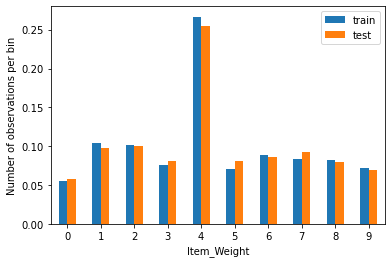

In [41]:
t1 = X_train_bin.groupby(['Item_Weight'])['Item_Weight'].count() / len(X_train_bin)
t2 = X_test_bin.groupby(['Item_Weight'])['Item_Weight'].count() / len(X_test_bin)

# concatenate aggregated views
tmp = pd.concat([t1, t2], axis=1)
tmp.columns = ['train', 'test']

# plot
tmp.plot.bar()
plt.xticks(rotation=0)
plt.ylabel('Number of observations per bin')

Text(0, 0.5, 'Number of observations per bin')

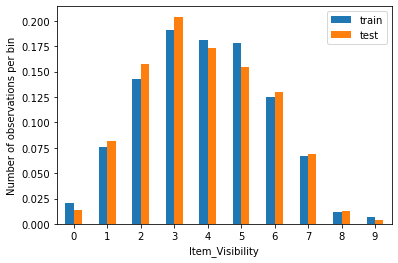

In [42]:
t1 = X_train_bin.groupby(['Item_Visibility'])['Item_Visibility'].count() / len(X_train_bin)
t2 = X_test_bin.groupby(['Item_Visibility'])['Item_Visibility'].count() / len(X_test_bin)

# concatenate aggregated views
tmp = pd.concat([t1, t2], axis=1)
tmp.columns = ['train', 'test']

# plot
tmp.plot.bar()
plt.xticks(rotation=0)
plt.ylabel('Number of observations per bin')

### Intervals of Equal Frequency

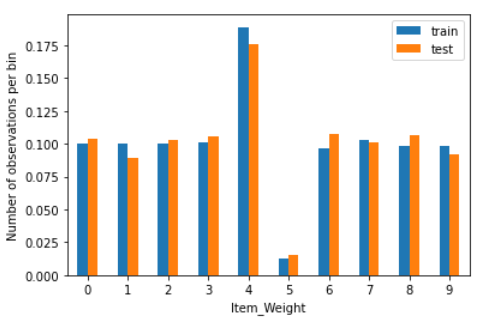

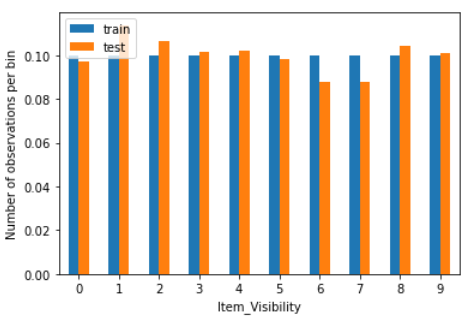

From the above 2 methods for binning, it can be seen that by using intervals of equal width method results in a more normal distribution than using equal frequency. Furthermore, it is very obvious that by binning using equal frequency for 'Item_Weight', there is an outlier. Since the purpose of binning is to minimise the influence of outliers and to change the distribution of skewed variables, the results from using intervals of equal width method is much better. Hence, for my initial and final model, I used the equal width method. 

## Step 8: Feature Engineer <a id="featureengineer"></a>

### Feature Scaling
Feature scaling is used to deal with the different variables that has different ranges of numerical values and make it so that all the variables are standardise in a fixed range. Many machine learning algorithms are sensitive to the scale and magnitude of the variables. 

If we do not do scaling, the machine learning algorithm will regard greater values as higher and smaller values as lower, regardless of the unit of the values. The higher values will impact the model more. For example, in this particular case, the maximum retail price of a product is considered to be much larger than the visibility of the product. 

This will result in the algorithm to give wrong predictions. Hence, the need for feature scaling to unite all values to the same magnitude. Furthermore, scaling will help the algorithm to be faster, improving the model performance as well.

Scaling is done at the last step before generating the results for the model performance. This is because after transforming of the numerical and categorical variables and binning, the values may change drastically or change from a categorical value to a numerical value. Hence, we would want to scale everything to make sure that all the variables are of the same magnitude. 

Standardization and Min-Max Normalization is the most common ways of scaling as they often produce the best results. However, we will be looking at all the different types of scaling techniques taught first before deciding on the final technique to use. These other techniques are:
- Maximum Absolute Scaling which is used to scale the data to its maximum value.
- Mean Normalization which centres the variable at 0 and rescales the distribution to the value range. 
- Robust Scaling whereby the median value is subtracted from the observations and results is divided by the inter-quartile range. It is also recommended to use this method if the data contains outliers. In this case, even though the data does not contain outliers, we will still be experimenting with this method. 

To make it easier to see the distribution after scaling, I split the variables into numerical, categorical-ordinal encoding, categorical-one hot encoding.

In [43]:
scaler = MinMaxScaler() #set up scaler

scaler.fit(X_train_bin) #fit scaler to train set
X_train_scaled = scaler.transform(X_train_bin) #transform train set
X_test_scaled = scaler.transform(X_test_bin) #transform test set

In [44]:
#transform returned NumPy arrays to dataframe
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train_bin.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test_bin.columns)

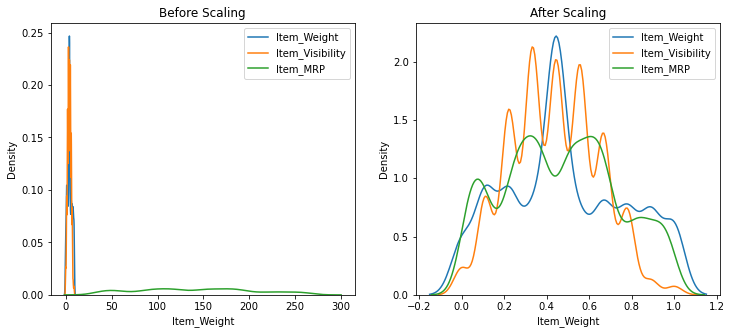

In [45]:
#comparing before and after scaling of numerical variables
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 5))

# before scaling
ax1.set_title('Before Scaling')
sns.kdeplot(X_train_bin['Item_Weight'], ax=ax1, label ='Item_Weight')
sns.kdeplot(X_train_bin['Item_Visibility'], ax=ax1, label ='Item_Visibility')
sns.kdeplot(X_train_bin['Item_MRP'], ax=ax1, label ='Item_MRP')
ax1.legend()

# after scaling
ax2.set_title('After Scaling')
sns.kdeplot(X_train_scaled['Item_Weight'], ax=ax2, label ='Item_Weight')
sns.kdeplot(X_train_scaled['Item_Visibility'], ax=ax2, label ='Item_Visibility')
sns.kdeplot(X_train_scaled['Item_MRP'], ax=ax2, label ='Item_MRP')
ax2.legend()
plt.show()

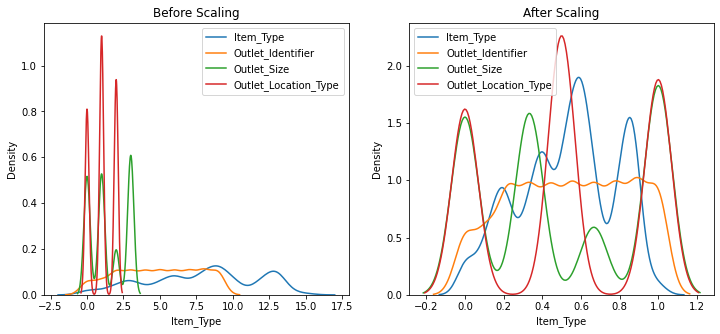

In [46]:
#comparing before and after scaling of categorical variables that went through ordinal 

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 5))

# before scaling
ax1.set_title('Before Scaling')
sns.kdeplot(X_train_bin['Item_Type'], ax=ax1, label ='Item_Type')
sns.kdeplot(X_train_bin['Outlet_Identifier'], ax=ax1, label ='Outlet_Identifier')
sns.kdeplot(X_train_bin['Outlet_Size'], ax=ax1, label ='Outlet_Size')
sns.kdeplot(X_train_bin['Outlet_Location_Type'], ax=ax1, label ='Outlet_Location_Type')
ax1.legend()

# after scaling
ax2.set_title('After Scaling')
sns.kdeplot(X_train_scaled['Item_Type'], ax=ax2, label = 'Item_Type')
sns.kdeplot(X_train_scaled['Outlet_Identifier'], ax=ax2, label ='Outlet_Identifier')
sns.kdeplot(X_train_scaled['Outlet_Size'], ax=ax2, label ='Outlet_Size')
sns.kdeplot(X_train_scaled['Outlet_Location_Type'], ax=ax2, label ='Outlet_Location_Type')
ax2.legend()
plt.show()

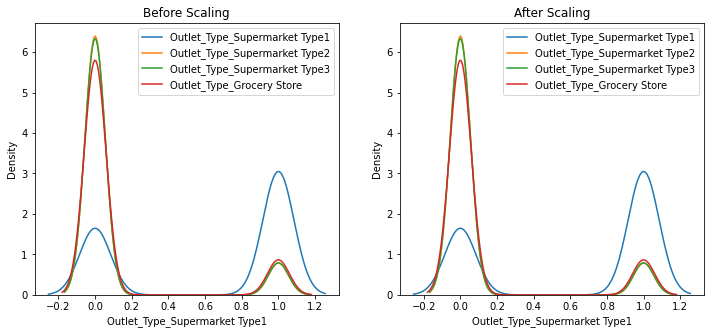

In [47]:
#comparing before and after scaling of categorical variables that went through one hot encoding

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 5))

# before scaling
ax1.set_title('Before Scaling')
sns.kdeplot(X_train_bin['Outlet_Type_Supermarket Type1'], ax=ax1, label ='Outlet_Type_Supermarket Type1')
sns.kdeplot(X_train_bin['Outlet_Type_Supermarket Type2'], ax=ax1, label ='Outlet_Type_Supermarket Type2')
sns.kdeplot(X_train_bin['Outlet_Type_Supermarket Type3'], ax=ax1, label ='Outlet_Type_Supermarket Type3')
sns.kdeplot(X_train_bin['Outlet_Type_Grocery Store'], ax=ax1, label ='Outlet_Type_Grocery Store')
ax1.legend()

# after scaling
ax2.set_title('After Scaling')
sns.kdeplot(X_train_scaled['Outlet_Type_Supermarket Type1'], ax=ax2, label ='Outlet_Type_Supermarket Type1')
sns.kdeplot(X_train_scaled['Outlet_Type_Supermarket Type2'], ax=ax2, label ='Outlet_Type_Supermarket Type2')
sns.kdeplot(X_train_scaled['Outlet_Type_Supermarket Type3'], ax=ax2, label ='Outlet_Type_Supermarket Type3')
sns.kdeplot(X_train_bin['Outlet_Type_Grocery Store'], ax=ax2, label ='Outlet_Type_Grocery Store')
ax2.legend()
plt.show()

### Numerical variables

#### Standardization
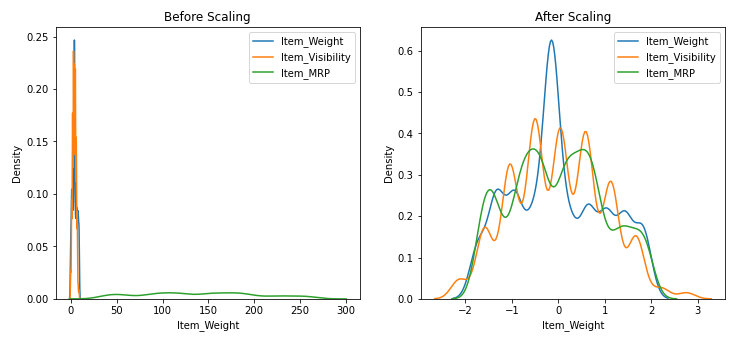

#### Mean normalisation
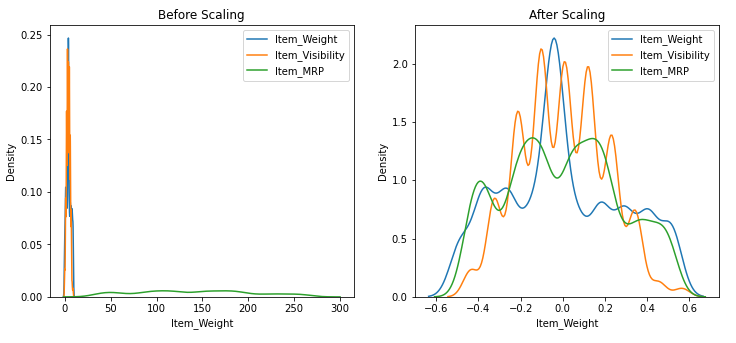

#### Maximum absolute
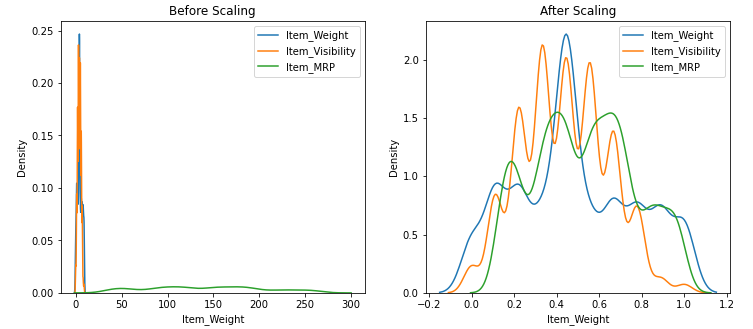

#### Robust scaling
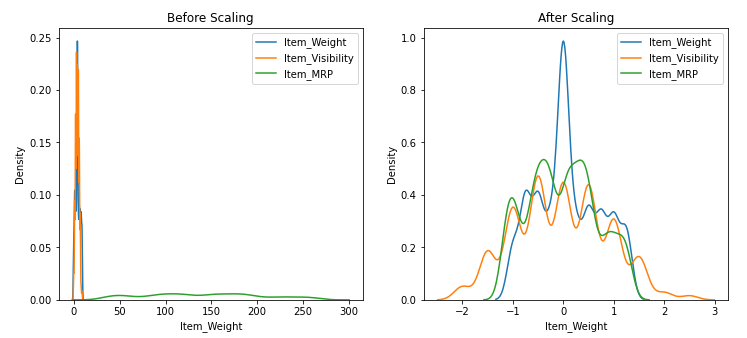

### Categorical Variables - Ordinal encoding

#### Standardization
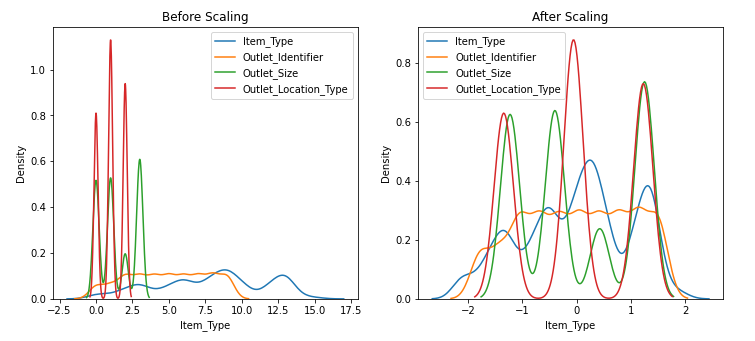

#### Mean normalisation
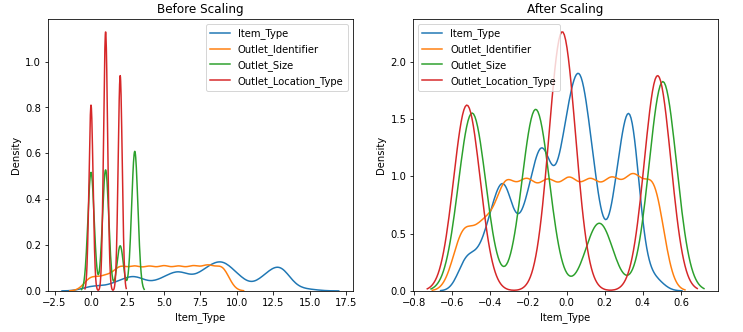

#### Maximum absolute
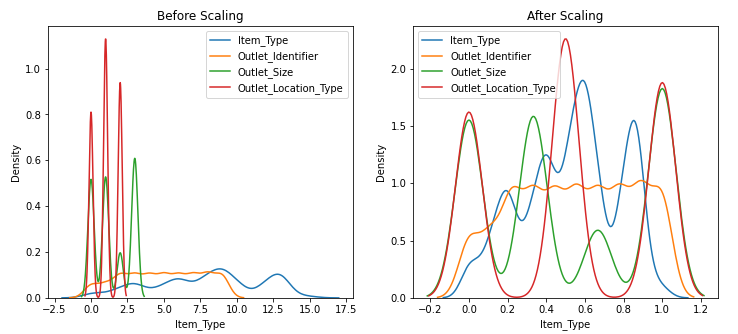

#### Robust scaling
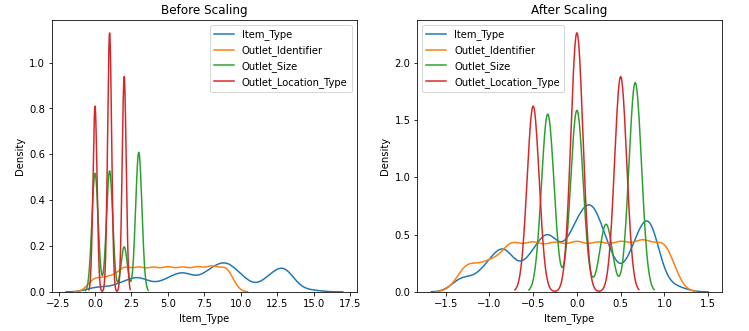

### Categorical Variable - One hot encoding

#### Standardization
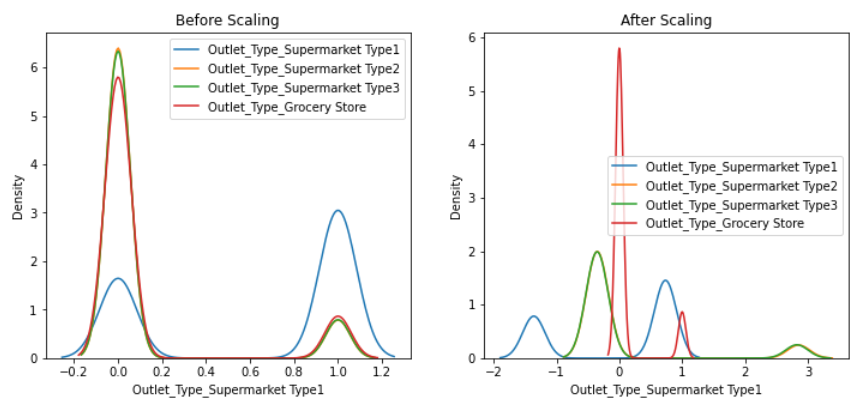

#### Mean normalization
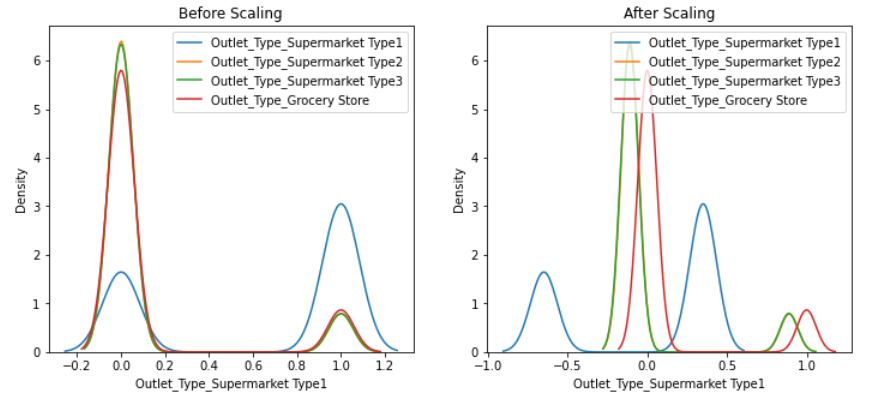

#### Maximum absolute
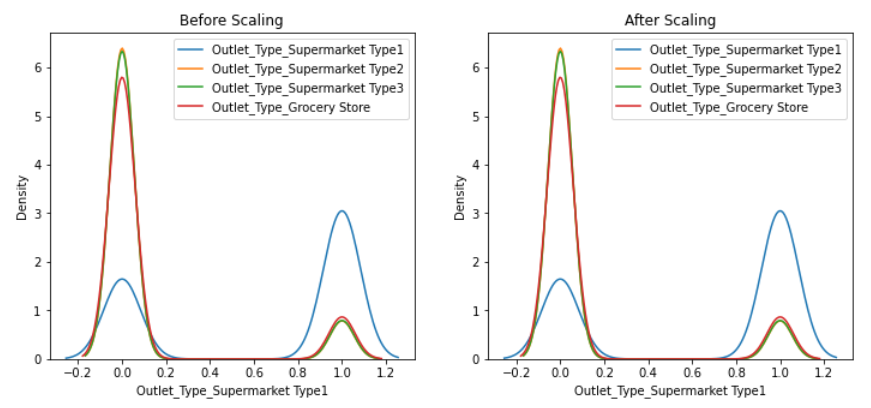

#### Robust scaling
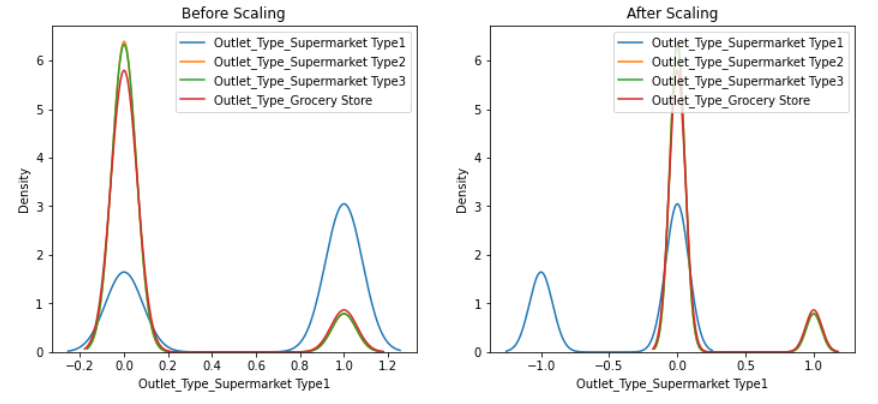

From all the visualisations above, we can see that after scaling, the variables are seen to be more normally distributed.

For the first trial, the main reason that I used the standardization method is because it is known to be the best method to use for scaling. The results of standardization represents the amount of standard deviations the observation deviates from the mean.

However, after trying to improve the model, I realised that the Min-Max Normalisation technique is more suitable to be used to scale compared to standardization. This is because:
1.	It is used when the variables are of different scales and magnitude as compared to standardization whereby we want to ensure zero mean and unit standard deviation.
2.	It is useful when the distribution is unknown or the distribution of the variables are not normal, which in this case, is not that normal.
3.	It is used when there are no outliers as it is very affected by outliers. As discussed previously in the data cleaning section, I do not deem the "outliers" as outliers but legitimate data.

Moreover, when comparing the different scaling techniques, using the Min-Max scaler improved the model performance results the most. 

## Step 9: Linear Regression Modelling <a id="regressionmodel"></a>

Linear regression is defined as a machine learning model in which the model finds the best fit linear line between the independent and dependent variables in which the aim is to find the best fit linear line and the optimal values of intercept and coefficients such that errors are minimized. For the purpose of this analysis, the goal is to use the X variables e.g. columns other than item outlet sales,to predict the item outlet sales (y variable, or target variable).
### Building and Evaluating the Model
In order to evaluate the model performance of a linear regression model, a range of measures can be used, but in this ASG1 we will focus on only 2:

- Root Mean Square Error (RMSE): The RMSE is the square root of the variance of the residuals, that is, the squared differences between prediction and actual observation. Lower values of RMSE indicate better fit and model performance.
- R-Square: R-square represents the percentage of the response variable variation that is explained by a linear model. The closer to 1.0 the value of R-square, the more indicative of a better fit and model performance.

### Final model trial results
For the final model, I did these data pre-processing and transformation methods.
- Removing of rows with visibility = 0
- No capping of outliers
- Only transforming numerical variable 'Item_Visibility' 
- Using ordinal and one hot encoding to encode categorical variables
- Using Equal Width Discretization to do binning
- Using Min-Max normalization to scale

In [48]:
# assign your fully cleaned and transformed data contained within your versions of 
# X_train_student_final_premodel_version, X_test_student_final_premodel_version,
# y_train_student_final_premodel_version and y_test_student_final_premodel_version into
# the prepared variables below, for a simple linear regression model

In [49]:
X_train_final = X_train_scaled
X_test_final = X_test_scaled

y_train_final = y_train
y_test_final = y_test

In [50]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

In [51]:
# Build Linear Regression Model
model_linear_regression = LinearRegression()
model_linear_regression.fit(X_train_final, y_train_final)

# Evaluate the Linear Regression Model using Root Mean Square Error (RMSE)
# The lower RMSE, the better the model performance
print('train_rmse:', mean_squared_error(y_train_final, model_linear_regression.predict(X_train_final)), 
      '\n test_rmse:', mean_squared_error(y_test_final, model_linear_regression.predict(X_test_final)))

# Evaluate the Linear Regression Model using R-Square
# The closer the r-square value to 1, the better the model performance
print('train_r-sq:', r2_score(y_train_final, model_linear_regression.predict(X_train_final)), 
      '\n test_r-sq:', r2_score(y_test_final, model_linear_regression.predict(X_test_final)))

train_rmse: 1239806.6819942733 
 test_rmse: 1324522.7135543833
train_r-sq: 0.5689101309748552 
 test_r-sq: 0.5539324576165652


### Trial 1

My first initial trial consists of all the methods and assumptions that I felt that would create the best model results. 

Assumptions:
- Visibility = 0 means that it is not displayed in the store and thereby should not have any sales. Rows with visibility = 0 were dropped.

Methods:

- Numerical transformation - Compared all the transformation methods and picked the method that made the numerical variables the most normally distributed ('Item_Visibility': used cube root transformation). Else, if the plot of the variables are very similar, I went with the method that is the most commonly used, which is the Yeo-Johnson transformation method. 

- Encoding Categorical variables - Used ordinal encoding as it is able to retain order and does not create new columns which might take up alot of memory space. It is a method that does not lead to information loss due to having to replace different categories with the same value. 

- Binning - Compared between the binning methods and chose the method that made variables more normally distributed, which is the equal width discretization method. 

- Scaling - Went with the most common method which is standardization. 

Below is the linear regression model scores:
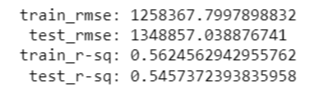

### Trial 2

For trial 2, I did not drop rows whereby visibility = 0 to check whether my assumption made sense. The other transformation methods is the same as trial 1.
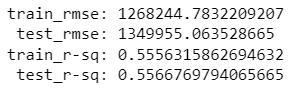
Comparing the results of trial 1 and 2, we can see that trial 2 has a worse model performance. This also proves that my theory is correct and that it was better to drop rows whereby visibility = 0.  

### Trial 3

Since I did not cap the outliers as I deemed that those values outside the boxplot was legitimate data, I tried capping 'Item_Visibility' to see whether the model performance would improve. The transformation methods are the same as in trial 1.
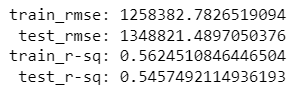
Comparing trial 3 with trial 2, we can see that the model performance improved. Even though it improved, I still chose not to cap the outliers as it will affect the results of the predicted sales values. 

### Trials 4-11

For subsequent trials for transformations, I went down each step and see for each step which transformation method made the most sense and also achieved a better model performance. I then replace the best method and used that method to do the comparison of other transformation methods in the subsequent steps. 

For trials 4-12, I experimented with the different numerical transformation methods for 'Item_Weight'. Comparing all the results against trial 3, I found out that when there was no transformation done for 'Item_Weight', the model performance improved. 
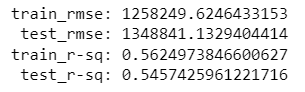
This tells me that there was no point in transforming as transforming 'Item_Weight' does not make the distribution more normal.

### Trials 12-18

For trials 12-18, I once again experimented with the different numerical transformation methods for 'Item_Visibility'. Comparing all the results against the model score with no transformation done to 'Item_Weight', all the other transformations except cube root transformation done to 'Item_Visibility' worsen the model score. When there was no transformation done for 'Item_Visibility', the model performance worsened as well, which can be seen below. 
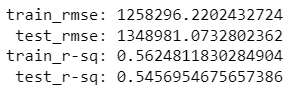

### Trials 19-25

For trials 19-25, comparing the model results after transforming 'Item_MRP' with the different numerical transformations against the model score with no transformation done to 'Item_Weight', it could be seen that when there was no transformation done to 'Item_MRP', the scores improved as seen below.
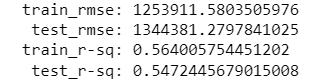
This once again tells me that there was no point in transforming 'Item_MRP' as it does not make the distribution more normal.

### Trial 26

For trial 26, I tried doing one hot encoding to some of the variables on top of ordinal encoding as it is known to make the training data more expressive, resulting in better model performance results. I only used one hot encoding for the 'Outlet_Type' as it is the only variable that does not have too many categories and no order. Upon using one hot encoding, my model results can be seen to improve by a large number compared to the other improvements.
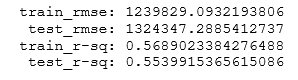
Hence, I added one hot encoding into my final model.

### Trial 27

For trial 27, I tried using equal frequency discretization for binning instead of equal width discretization. By using the equal frequency discretization, it could be seen that for 'Item_Weight', there was an outlier and for 'Item_Visibility', the values was not normally distributed. Moreover, the model performance score when using equal width discretization was better.
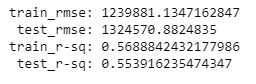
Hence, equal width discretization method was used for binning.

### Trial 28-32

For trials 28-32, I used the different scaling methods and see which one gives the best model score. After comparing all the visualisations of the different scaling methods, the after scaling visualisation looks very similar to each other. Hence, I looked at the model score. There was not much change in the model scores. In fact, most of the model scores were the same. Only using standardization had a large difference compared to the rest of the methods (compare trial 26's model score with the score below).
Since the scores of the other methods are similar, I will use the score that uses Min-Max Normalization for comparison:
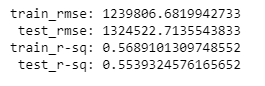

It is can be seen that the train RMSE decreased and the test RMSE increased compared to trial 26's score while both the train and test r-sq increased. Since the difference is not much, it tells me that the model is vulnerable to overfitting. Generally, not using standardization will produce better model results. Hence, I chose to use min-max normalization as it made more sense as explained in the feature scaling section. 

## Summary and further improvements <a id="summary"></a>

Firstly, I found out that my assumption to remove visibility = 0 is valid as it helped to improve the model score. Secondly, since there are some values that has only a few rows in the dataset, after train test splitting, there is a chance that all of these rows will go into the test data. This may cause a problem later on when doing encoding of categorical variables. Hence, we have to drop that particular column. We can also change the random_state in the code for train test split to shuffle to another set of randomly generated data in train and test dataset. I also found out that not transforming some of the numerical variables, using one hot encoding and binning helped to improve the model score. It can be also seen that from comparing trial 26 and the final trial model scores, the train RMSE decreased and the test RMSE increased, implying that it is vulnerable to being overfitted. 

To further improve on my model for better predicting, I can firstly use one hot encoding for 'Item_Type' as it is known to produce better model results. In turn, this will create more columns. After that, I will use the Principal Component Analysis to reduce the number of columns by taking into account of values of each variable in the training matrix in comparison to one another and with respect to the target feature. It will attempt to maximise the explanation of the variability of the original data and this will help to save time yet having a better model performance.

Secondly, since my model is vulnerable to being overfitted, I could introduce more clean data to be trained so that the model will be able to know the relationship between the input attributes and the output variable.

## References

- Slides provided during lessons

- https://medium.com/fintechexplained/ever-wondered-why-normal-distribution-is-so-important-110a482abee3

- https://www.geeksforgeeks.org/feature-encoding-techniques-machine-learning/

- https://analyticsindiamag.com/a-complete-guide-to-categorical-data-encoding/#:~:text=float%20or%20integer.-,Encoding%20categorical%20data%20is%20a%20process%20of%20converting%20categorical%20data,give%20and%20improve%20the%20predictions.

- https://www.geeksforgeeks.org/ml-feature-scaling-part-2/

- https://www.analyticsvidhya.com/blog/2021/05/feature-scaling-techniques-in-python-a-complete-guide/

- https://www.v7labs.com/blog/overfitting